<a href="https://colab.research.google.com/github/mrshamshir/GAN-and-DCGAN-for-generating-MNIST-handwritten-digits/blob/main/DCGAN_for_generating_MNIST_handwritten_digits.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Deep Convolutional GAN (DCGAN)(20 points)

### Goal
In this notebook, you're going to create another GAN using the MNIST dataset. You will implement a Deep Convolutional GAN (DCGAN), a very successful and influential GAN model developed in 2015.

*Note: [here](https://arxiv.org/pdf/1511.06434v1.pdf) is the paper if you are interested! It might look dense now, but soon you'll be able to understand many parts of it :)*

### Learning Objectives
1.   Get hands-on experience making a widely used GAN: Deep Convolutional GAN (DCGAN).
2.   Train a powerful generative model.


In [ ]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for testing purposes, please do not change!


def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28)):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=5)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    plt.show()

## Generator
The first component you will make is the generator. You may notice that instead of passing in the image dimension, you will pass the number of image channels to the generator. This is because with DCGAN, you use convolutions which don’t depend on the number of pixels on an image. However, the number of channels is important to determine the size of the filters.

You will build a generator using 4 layers (3 hidden layers + 1 output layer). As before, you will need to write a function to create a single block for the generator's neural network.
<!-- From the paper, we know to "[u]se batchnorm in both the generator and the discriminator" and "[u]se ReLU activation in generator for all layers except for the output, which uses Tanh." -->
Since in DCGAN the activation function will be different for the output layer, you will need to check what layer is being created. You are supplied with some tests following the code cell so you can see if you're on the right track!

At the end of the generator class, you are given a forward pass function that takes in a noise vector and generates an image of the output dimension using your neural network. You are also given a function to create a noise vector. These functions are the same as the ones from the last assignment.

<details>
<summary>
<font size="3" color="green">
<b>Optional hint for <code><font size="4">make_gen_block</font></code></b>
</font>
</summary>

1. You'll find [nn.ConvTranspose2d](https://pytorch.org/docs/master/generated/torch.nn.ConvTranspose2d.html) and [nn.BatchNorm2d](https://pytorch.org/docs/master/generated/torch.nn.BatchNorm2d.html) useful!
</details>

In [ ]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: Generator
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        z_dim: the dimension of the noise vector, a scalar
        im_chan: the number of channels of the output image, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, z_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.z_dim = z_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(z_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN,
        corresponding to a transposed convolution, a batchnorm (except for in the last layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise
                      (affects activation and batchnorm)
        '''

        #     Steps:
        #       1) Do a transposed convolution using the given parameters.
        #       2) Do a batchnorm, except for the last layer.
        #       3) Follow each batchnorm with a ReLU activation.
        #       4) If its the final layer, use a Tanh activation after the deconvolution.

        # Build the neural block
        if not final_layer:
            return nn.Sequential(
                #### START CODE HERE ####
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size=kernel_size, stride=stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU()

                #### END CODE HERE ####
            )
        else: # Final Layer
            return nn.Sequential(
                #### START CODE HERE ####
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size=kernel_size, stride=stride),
                nn.Tanh()
                #### END CODE HERE ####
            )

    def unsqueeze_noise(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor,
        returns a copy of that noise with width and height = 1 and channels = z_dim.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, z_dim)
        '''
        return noise.view(len(noise), self.z_dim, 1, 1)

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor,
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, z_dim)
        '''
        x = self.unsqueeze_noise(noise)
        return self.gen(x)

def get_noise(n_samples, z_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, z_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
        n_samples: the number of samples to generate, a scalar
        z_dim: the dimension of the noise vector, a scalar
        device: the device type
    '''
    return torch.randn(n_samples, z_dim, device=device)

In [ ]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
'''
Test your make_gen_block() function
'''
gen = Generator()
num_test = 100

# Test the hidden block
test_hidden_noise = get_noise(num_test, gen.z_dim)
test_hidden_block = gen.make_gen_block(10, 20, kernel_size=4, stride=1)
test_uns_noise = gen.unsqueeze_noise(test_hidden_noise)
hidden_output = test_hidden_block(test_uns_noise)

# Check that it works with other strides
test_hidden_block_stride = gen.make_gen_block(20, 20, kernel_size=4, stride=2)

test_final_noise = get_noise(num_test, gen.z_dim) * 20
test_final_block = gen.make_gen_block(10, 20, final_layer=True)
test_final_uns_noise = gen.unsqueeze_noise(test_final_noise)
final_output = test_final_block(test_final_uns_noise)

# Test the whole thing:
test_gen_noise = get_noise(num_test, gen.z_dim)
test_uns_gen_noise = gen.unsqueeze_noise(test_gen_noise)
gen_output = gen(test_uns_gen_noise)

Here's the test for your generator block:

In [ ]:
# UNIT TESTS
try:
    assert tuple(hidden_output.shape) == (num_test, 20, 4, 4)
    assert hidden_output.max() > 1
    assert hidden_output.min() == 0
    assert hidden_output.std() > 0.2
    assert hidden_output.std() < 1
    assert hidden_output.std() > 0.5

    assert tuple(test_hidden_block_stride(hidden_output).shape) == (num_test, 20, 10, 10)

    assert final_output.max().item() == 1
    assert final_output.min().item() == -1

    assert tuple(gen_output.shape) == (num_test, 1, 28, 28)
    assert gen_output.std() > 0.5
    assert gen_output.std() < 0.8
    print("Success!")
except:
    print("Some of asserts have fail")

Success!


## Discriminator
The second component you need to create is the discriminator.

You will use 3 layers in your discriminator's neural network. Like with the generator, you will need create the function to create a single neural network block for the discriminator.
<!-- From the paper, we know that we need to "[u]se LeakyReLU activation in the discriminator for all layers." And for the LeakyReLUs, "the slope of the leak was set to 0.2" in DCGAN. -->
There are also tests at the end for you to use.
<details>
<summary>
<font size="3" color="green">
<b>Optional hint for <code><font size="4">make_disc_block</font></code></b>
</font>
</summary>

1. You'll find [nn.Conv2d](https://pytorch.org/docs/master/generated/torch.nn.Conv2d.html), [nn.BatchNorm2d](https://pytorch.org/docs/master/generated/torch.nn.BatchNorm2d.html), and [nn.LeakyReLU](https://pytorch.org/docs/master/generated/torch.nn.LeakyReLU.html) useful!
</details>

In [ ]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: Discriminator
class Discriminator(nn.Module):
    '''
    Discriminator Class
    Values:
        im_chan: the number of channels of the output image, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
    hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=16):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            self.make_disc_block(im_chan, hidden_dim),
            self.make_disc_block(hidden_dim, hidden_dim * 2),
            self.make_disc_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_disc_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a discriminator block of DCGAN,
        corresponding to a convolution, a batchnorm (except for in the last layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise
                      (affects activation and batchnorm)
        '''
        #     Steps:
        #       1) Add a convolutional layer using the given parameters.
        #       2) Do a batchnorm, except for the last layer.
        #       3) Follow each batchnorm with a LeakyReLU activation with slope 0.2.

        # Build the neural block
        if not final_layer:
            return nn.Sequential(
                #### START CODE HERE #### #
                nn.Conv2d(input_channels, output_channels, kernel_size=kernel_size, stride=stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2)

                #### END CODE HERE ####
            )
        else: # Final Layer
            return nn.Sequential(
                #### START CODE HERE #### #
                nn.Conv2d(input_channels, output_channels, kernel_size=kernel_size, stride=stride),
                #### END CODE HERE ####
            )

    '''
    Function for completing a forward pass of the discriminator: Given an image tensor,
    returns a 1-dimension tensor representing fake/real.
    Parameters:
        image: a flattened image tensor with dimension (im_dim)
    '''
    def forward(self, image):
        disc_pred = self.disc(image)
        return disc_pred.view(len(disc_pred), -1)

In [ ]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
'''
Test your make_disc_block() function
'''
num_test = 100

gen = Generator()
disc = Discriminator()
test_images = gen(get_noise(num_test, gen.z_dim))

# Test the hidden block
test_hidden_block = disc.make_disc_block(1, 5, kernel_size=6, stride=3)
hidden_output = test_hidden_block(test_images)

# Test the final block
test_final_block = disc.make_disc_block(1, 10, kernel_size=2, stride=5, final_layer=True)
final_output = test_final_block(test_images)

# Test the whole thing:
disc_output = disc(test_images)

Here's a test for your discriminator block:

In [ ]:
try:
    # Test the hidden block
    assert tuple(hidden_output.shape) == (num_test, 5, 8, 8)
    # Because of the LeakyReLU slope
    assert -hidden_output.min() / hidden_output.max() > 0.15
    assert -hidden_output.min() / hidden_output.max() < 0.25
    assert hidden_output.std() > 0.5
    assert hidden_output.std() < 1

    # Test the final block

    assert tuple(final_output.shape) == (num_test, 10, 6, 6)
    assert final_output.max() > 1.0
    assert final_output.min() < -1.0
    assert final_output.std() > 0.3
    assert final_output.std() < 0.6

    # Test the whole thing:

    assert tuple(disc_output.shape) == (num_test, 1)
    assert disc_output.std() > 0.25
    assert disc_output.std() < 0.5
    print("Success!")
except:
    print("Some of asserts have fail")

Success!


## Training
Now you can put it all together!
Remember that these are your parameters:
  *   criterion: the loss function
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   beta_1, beta_2: the momentum term
  *   device: the device type

<!-- In addition, be warned that **this runs very slowly on the default CPU**. One way to run this more quickly is to download the .ipynb and upload it to Google Drive, then open it with Google Colab, click on `Runtime -> Change runtime type` and set hardware accelerator to GPU and replace
`device = "cpu"`
with
`device = "cuda"`. The code should then run without any more changes, over 1,000 times faster.  -->


In [ ]:
##TODO
criterion = nn.BCELoss()
n_epochs = 10
z_dim = 100
display_step = 500
batch_size = 100
lr = 0.0002

# These parameters control the optimizer's momentum, which you can read more about here:
# https://distill.pub/2017/momentum/
beta_1 = 0.5
beta_2 = 0.999
device = 'cuda'
# device = 'cpu'
###TODO#############
# You can tranform the image values to be between -1 and 1 (the range of the tanh activation)
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=True, transform=transform),
    batch_size=batch_size,
    shuffle=True)

Then, you can initialize your generator, discriminator, and optimizers.

In [ ]:
gen = Generator(z_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr = lr , betas=(beta_1 , beta_2))
disc = Discriminator().to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr = lr, betas=(beta_1 , beta_2))

# You initialize the weights to the normal distribution
# with mean 0 and standard deviation 0.02
###TODO
def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        m.weight.data.normal_(0.0, 0.02)
        # if m.bias.data is not None:
        #     m.bias.data.zero_()
    if isinstance(m, nn.BatchNorm2d):
        m.weight.data.normal_(1.0, 0.02)
        m.bias.data.fill_(0)
###TTODO
gen = gen.apply(weights_init)
disc = disc.apply(weights_init)

Finally, you can train your GAN!
For each epoch, you will process the entire dataset in batches. For every batch, you will update the discriminator and generator. Then, you can see DCGAN's results!

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 0: Step 500: Generator loss: 0.582082282751799, discriminator loss: 0.8192587249279023


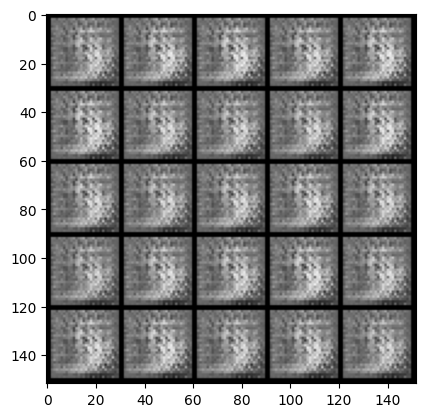

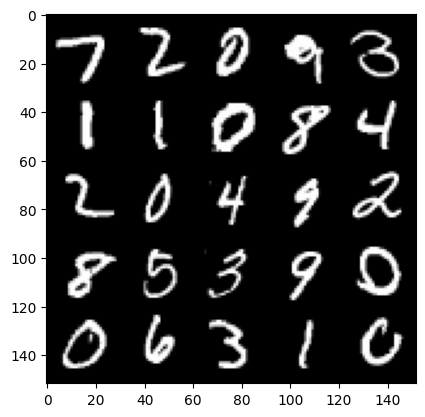

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 1: Step 1000: Generator loss: 0.8122709082365034, discriminator loss: 0.6669108266830439


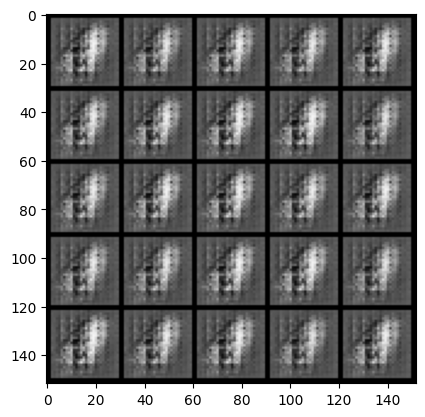

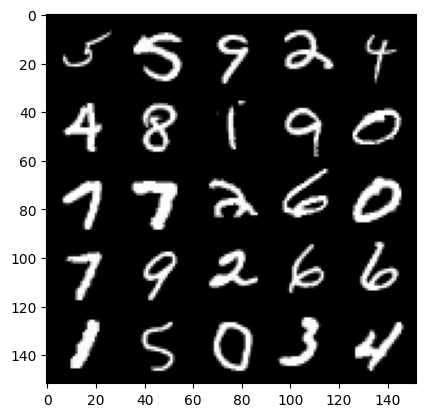

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 2: Step 1500: Generator loss: 0.8996729710102084, discriminator loss: 0.6263251201510435


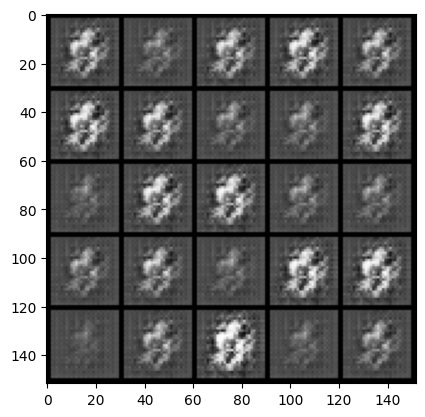

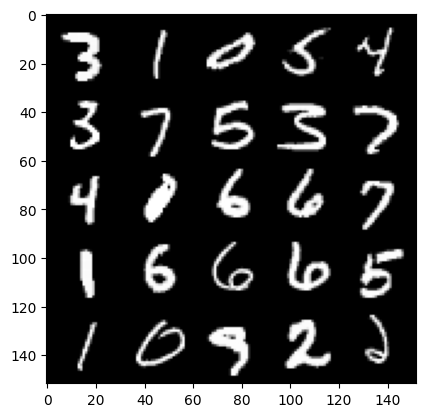

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 3: Step 2000: Generator loss: 0.9332803426980973, discriminator loss: 0.5940143662095065


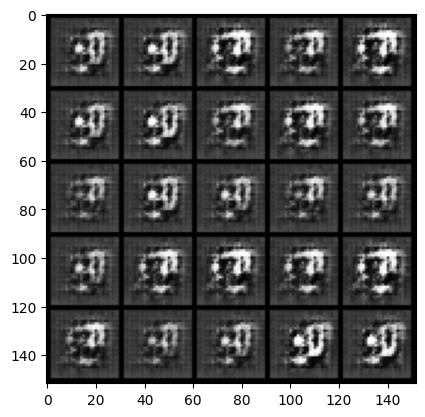

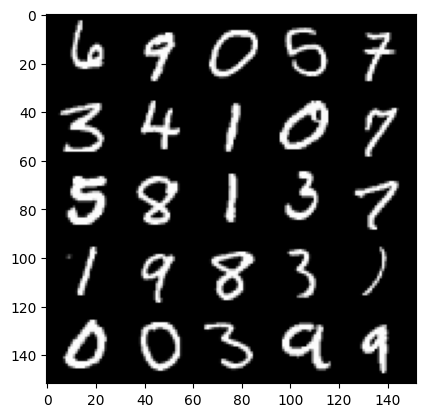

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 4: Step 2500: Generator loss: 0.9673920294642446, discriminator loss: 0.5655191659927368


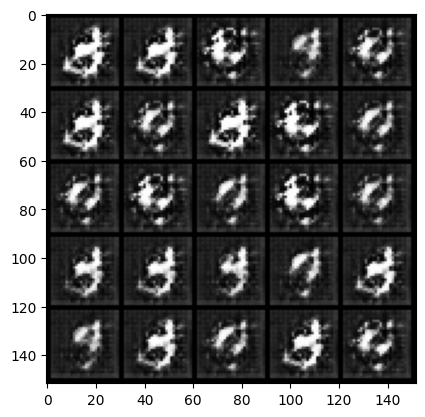

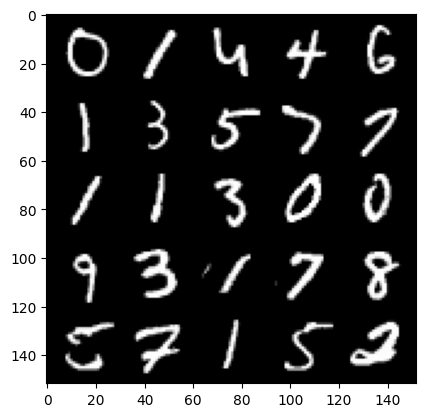

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 5: Step 3000: Generator loss: 1.1155988320112225, discriminator loss: 0.5207599199414252


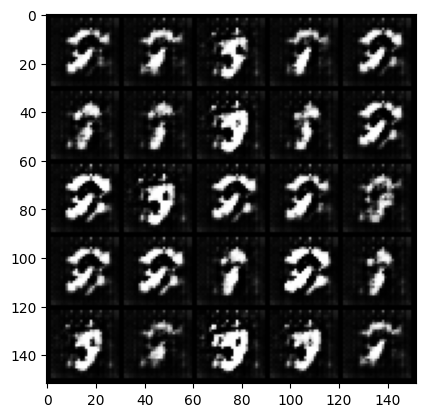

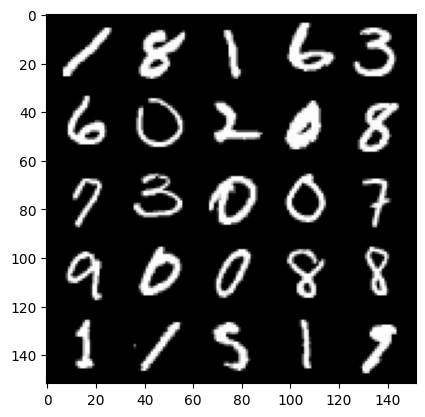

Epoch: 5: Step 3500: Generator loss: 1.093884683787822, discriminator loss: 0.5056664866805076


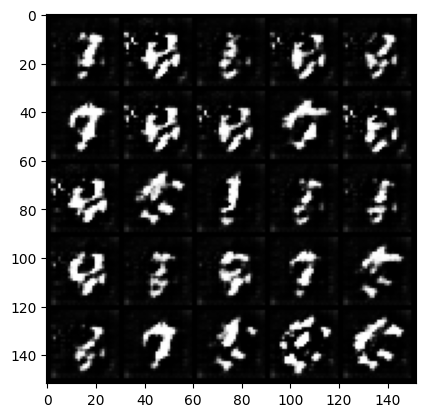

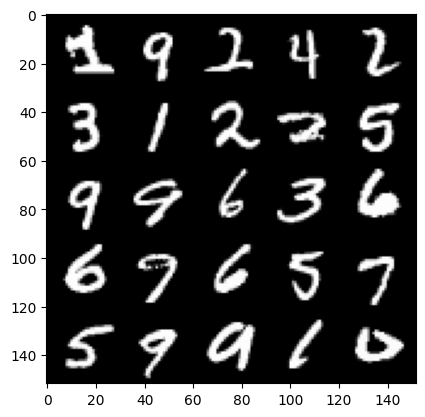

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 6: Step 4000: Generator loss: 1.0837149829268458, discriminator loss: 0.530959571838379


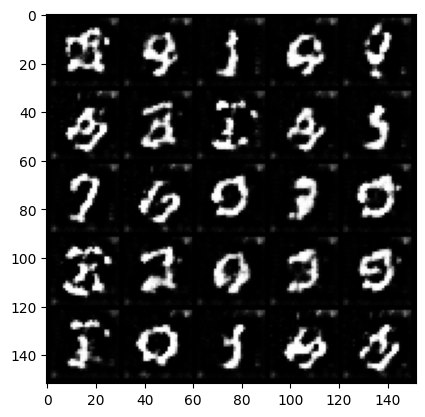

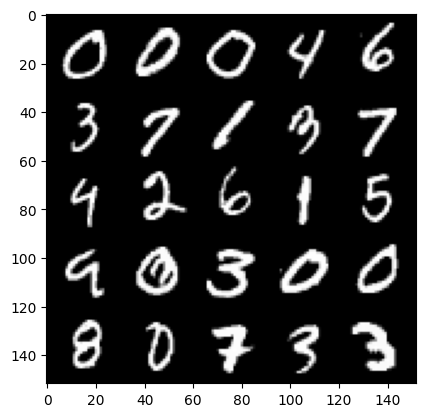

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 7: Step 4500: Generator loss: 1.0154754671454433, discriminator loss: 0.5598506405949593


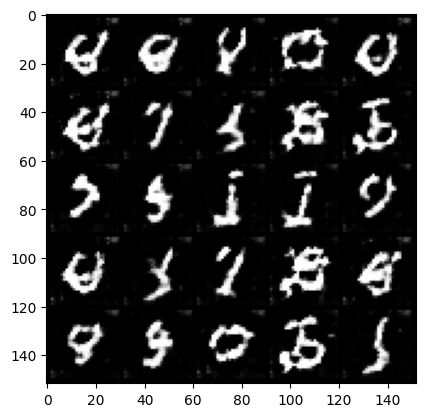

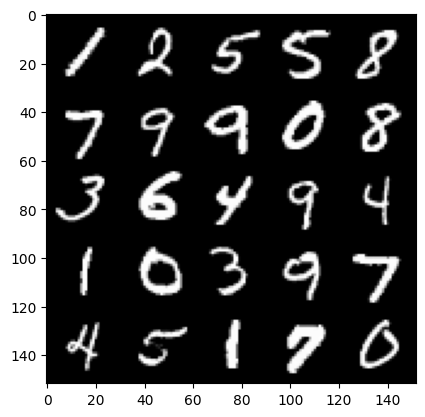

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 8: Step 5000: Generator loss: 0.9490139620900153, discriminator loss: 0.5942481235265732


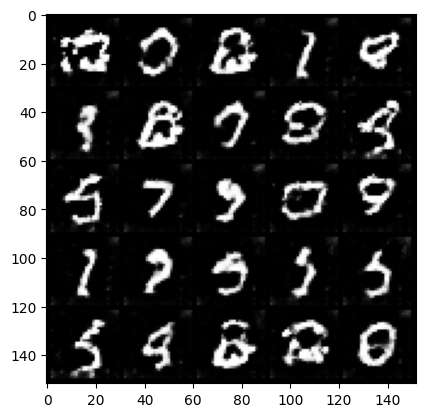

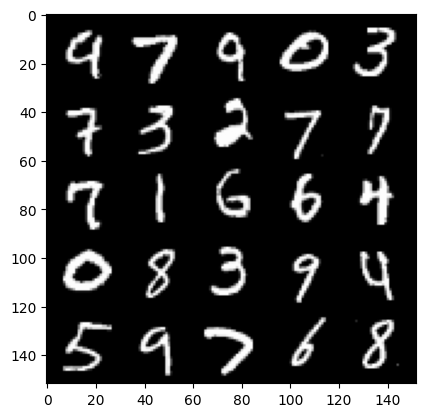

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 9: Step 5500: Generator loss: 0.901025778949261, discriminator loss: 0.6248133126497271


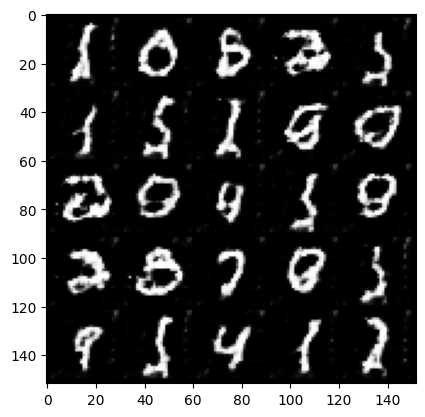

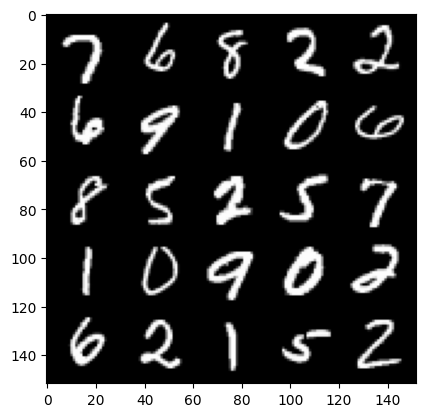

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 10: Step 6000: Generator loss: 0.8470401479005815, discriminator loss: 0.6478123414516453


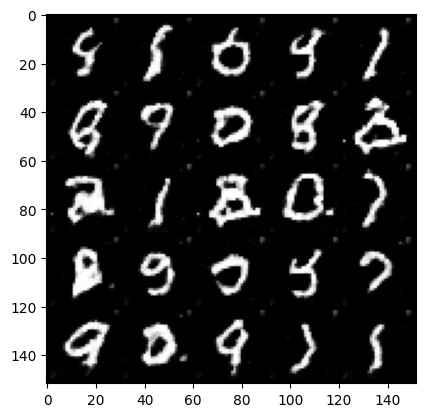

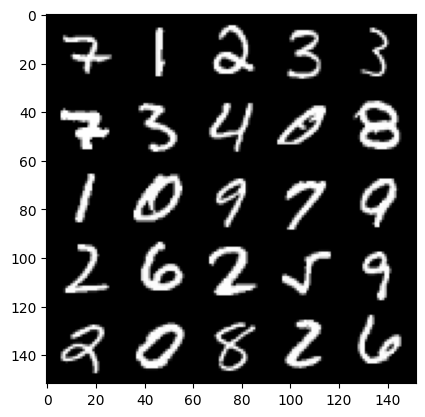

Epoch: 10: Step 6500: Generator loss: 0.8326486949920657, discriminator loss: 0.6565392162799834


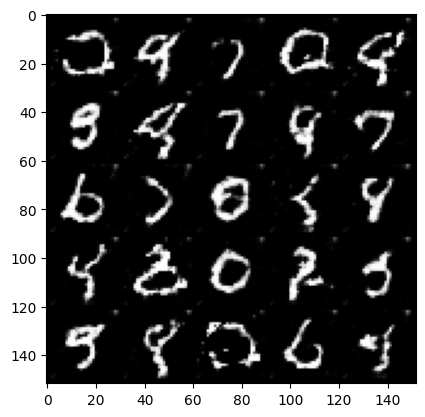

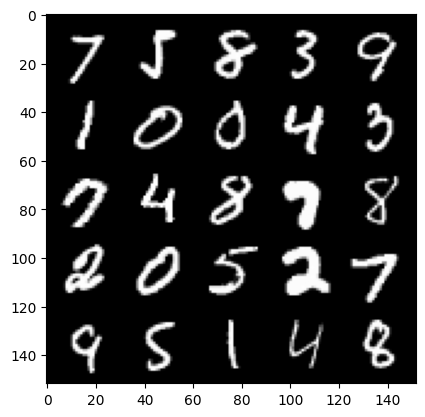

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 11: Step 7000: Generator loss: 0.819152355611324, discriminator loss: 0.662870990395546


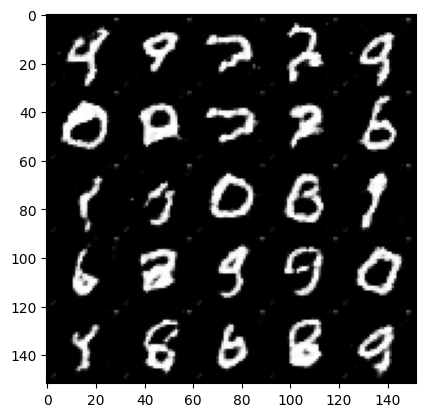

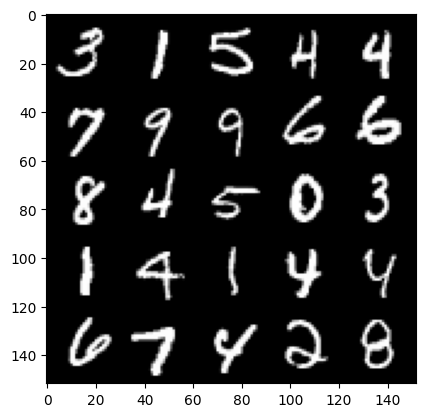

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 12: Step 7500: Generator loss: 0.8099054038524623, discriminator loss: 0.6701305589675913


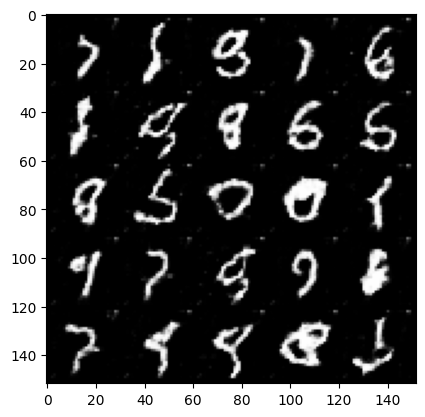

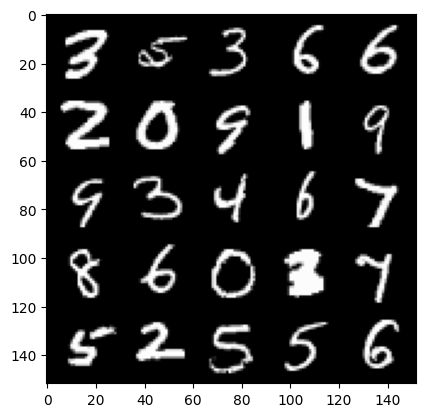

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 13: Step 8000: Generator loss: 0.7855462979078297, discriminator loss: 0.6772736030817035


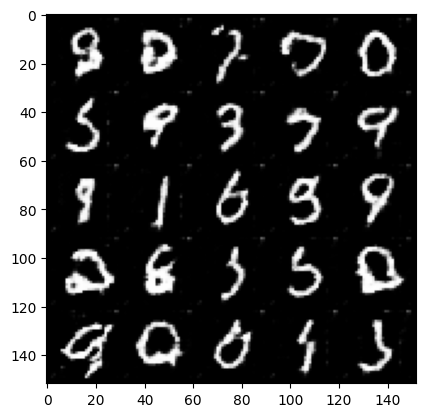

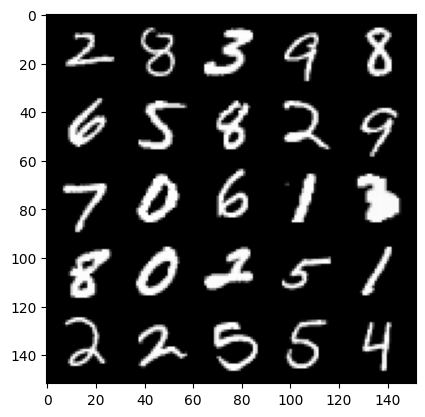

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 14: Step 8500: Generator loss: 0.7861157405376435, discriminator loss: 0.6789313337802896


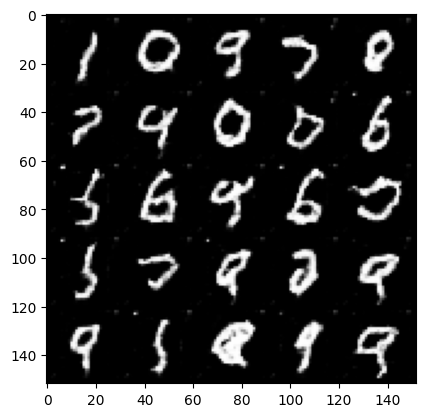

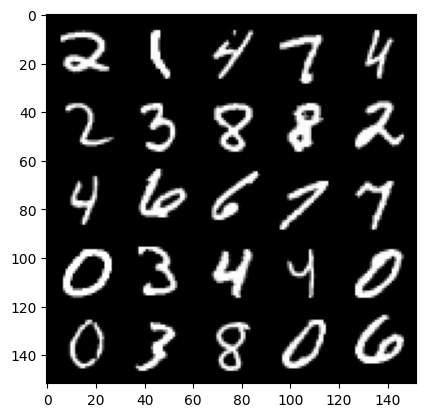

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 15: Step 9000: Generator loss: 0.7765026193261153, discriminator loss: 0.6805512032508849


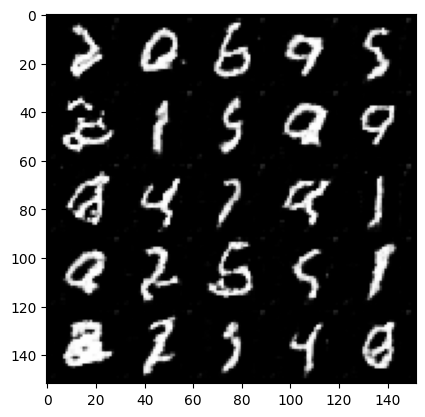

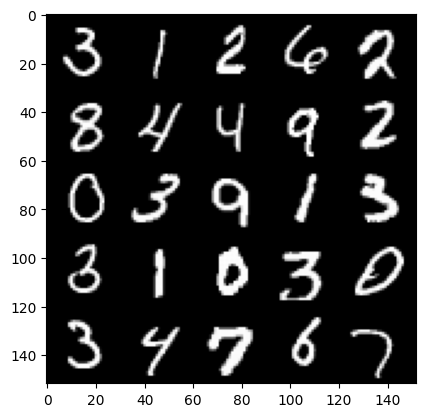

Epoch: 15: Step 9500: Generator loss: 0.7686046894788737, discriminator loss: 0.6814451087713247


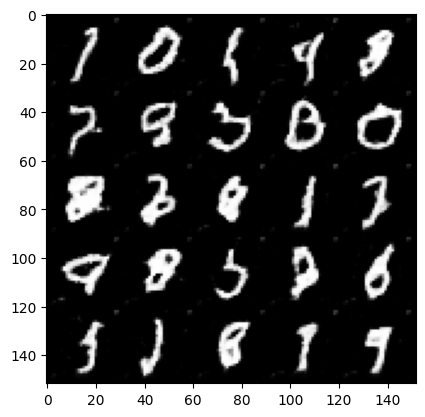

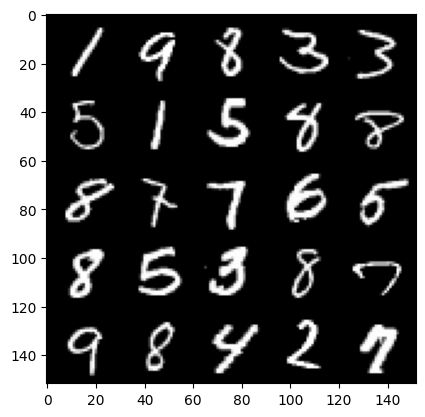

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 16: Step 10000: Generator loss: 0.7626570007801057, discriminator loss: 0.6841858010292053


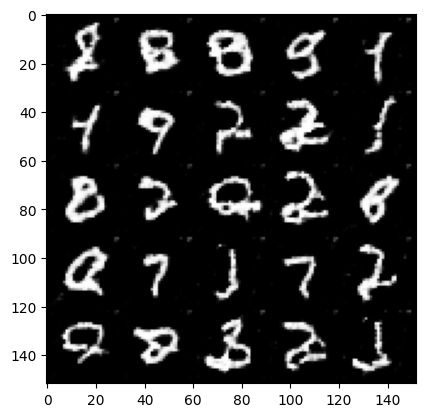

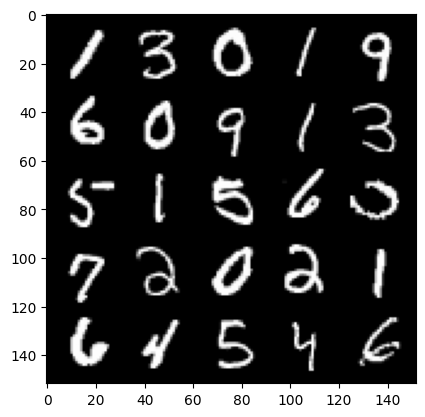

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 17: Step 10500: Generator loss: 0.7603846424818036, discriminator loss: 0.6850541727542869


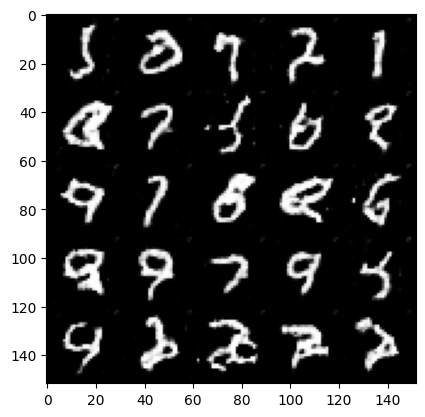

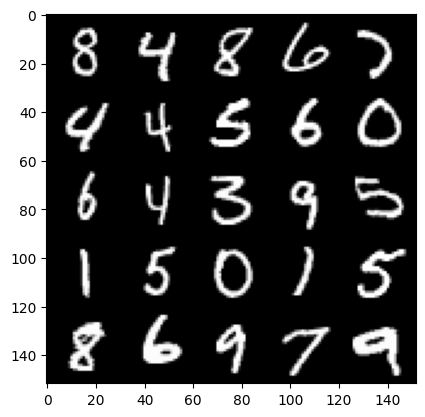

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 18: Step 11000: Generator loss: 0.7528698713779451, discriminator loss: 0.6876921491622932


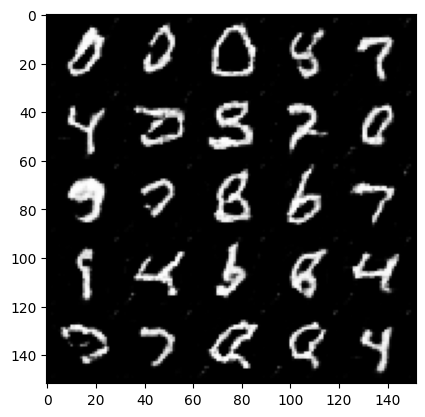

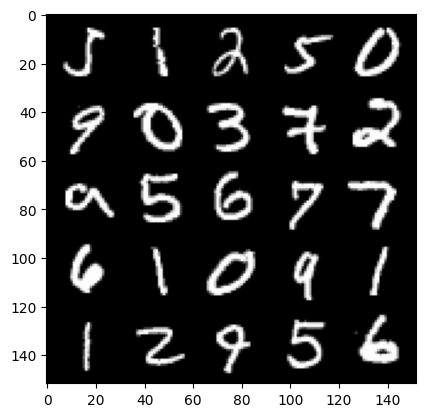

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 19: Step 11500: Generator loss: 0.7477477916479109, discriminator loss: 0.6887981528043744


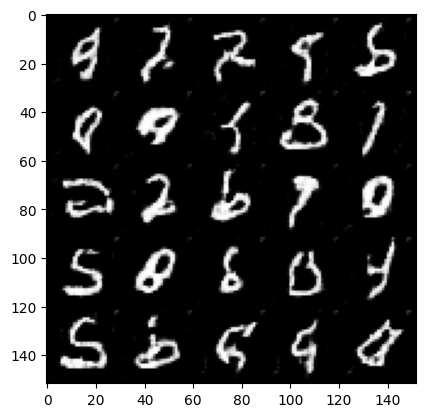

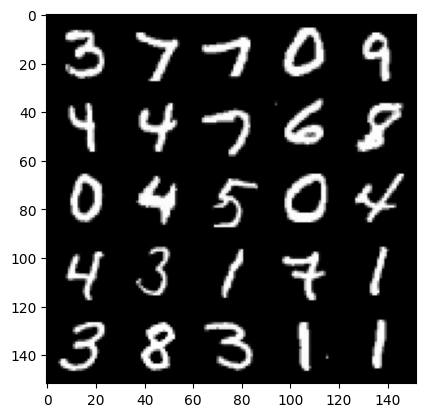

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 20: Step 12000: Generator loss: 0.7431071199178696, discriminator loss: 0.6917612746953966


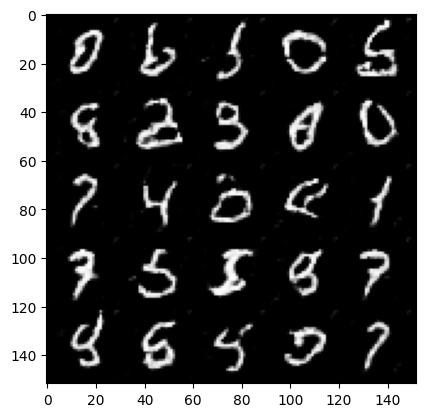

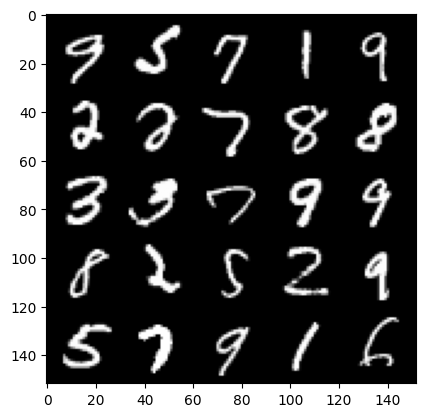

Epoch: 20: Step 12500: Generator loss: 0.7424193019866939, discriminator loss: 0.6927811317443853


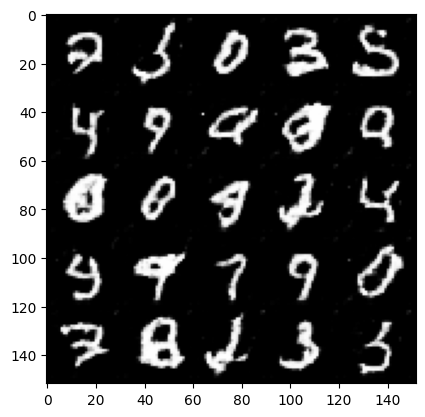

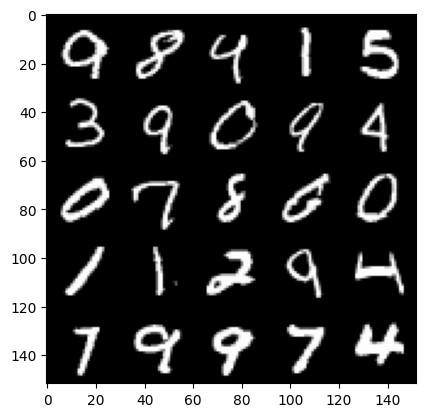

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 21: Step 13000: Generator loss: 0.736845118403434, discriminator loss: 0.6940190846920015


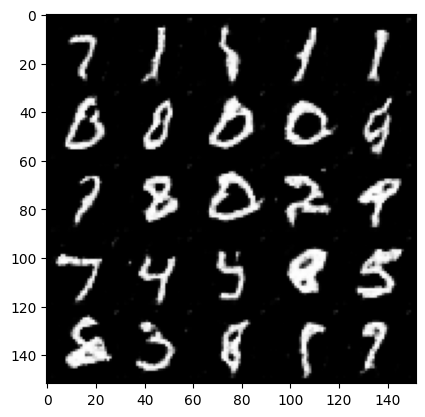

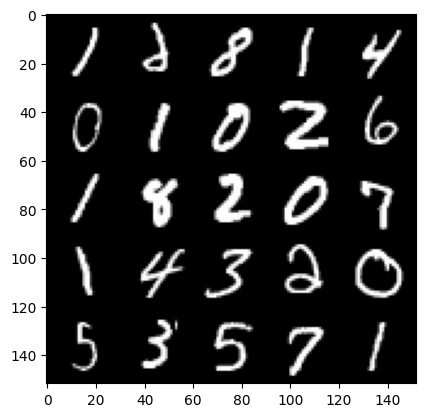

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 22: Step 13500: Generator loss: 0.7317618235349654, discriminator loss: 0.6948779453039163


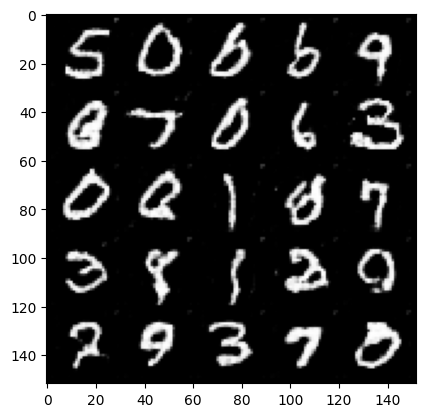

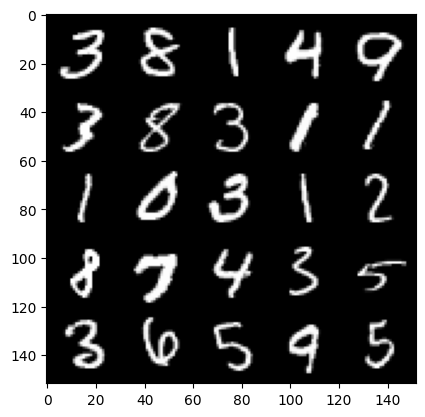

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 23: Step 14000: Generator loss: 0.7315807174444192, discriminator loss: 0.6941735066175466


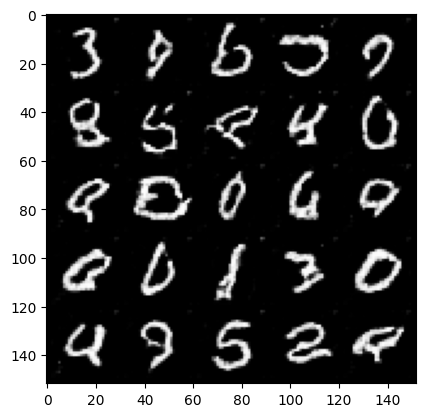

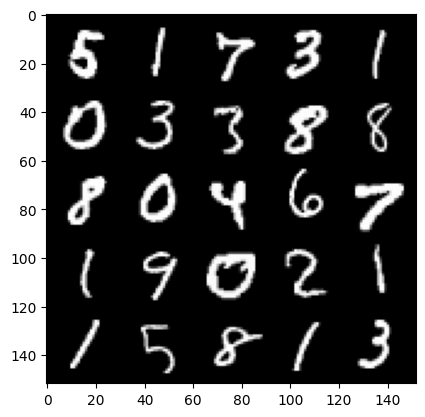

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 24: Step 14500: Generator loss: 0.7264542576074597, discriminator loss: 0.6953306013345717


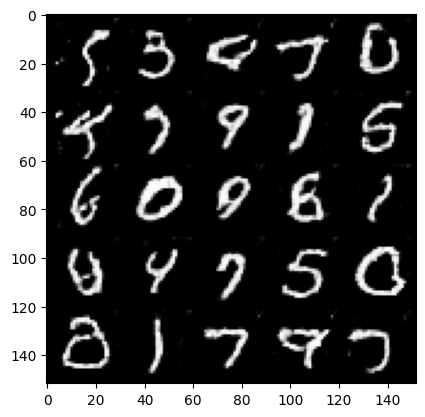

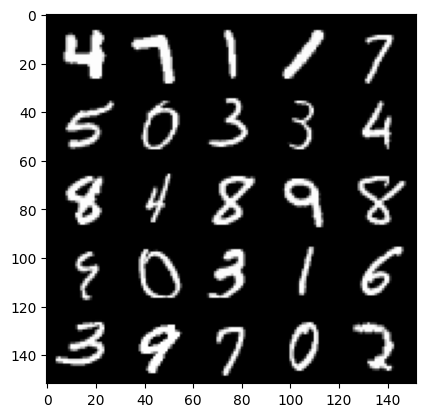

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 25: Step 15000: Generator loss: 0.7274086343050006, discriminator loss: 0.6959824030399323


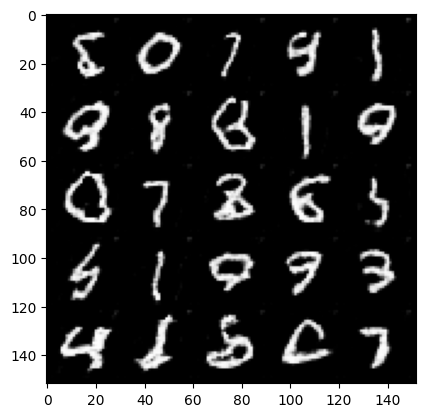

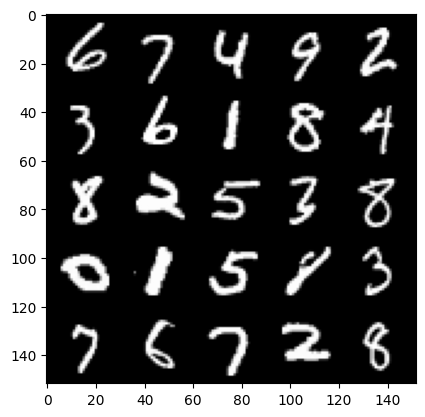

Epoch: 25: Step 15500: Generator loss: 0.7201651414632805, discriminator loss: 0.6965094490051269


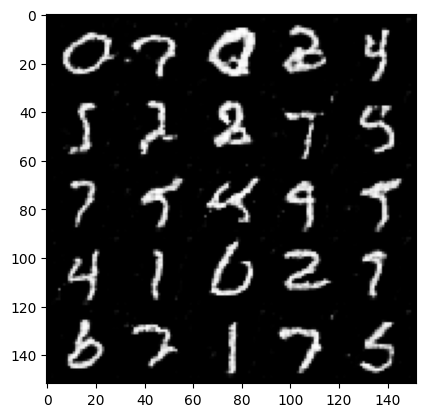

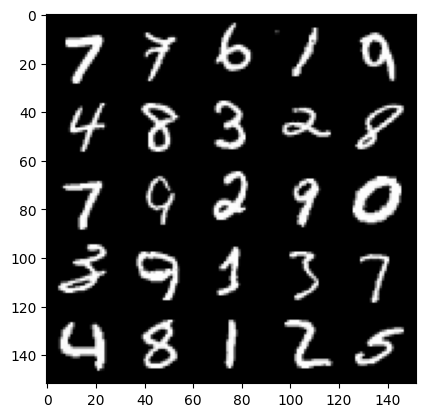

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 26: Step 16000: Generator loss: 0.7212994807958603, discriminator loss: 0.6974752018451683


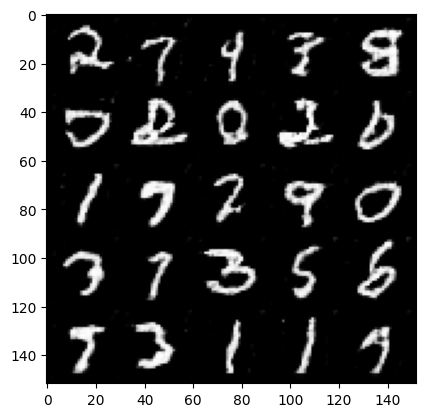

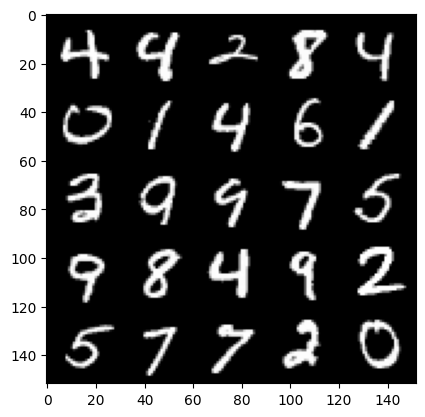

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 27: Step 16500: Generator loss: 0.7179105753898625, discriminator loss: 0.6977302445173256


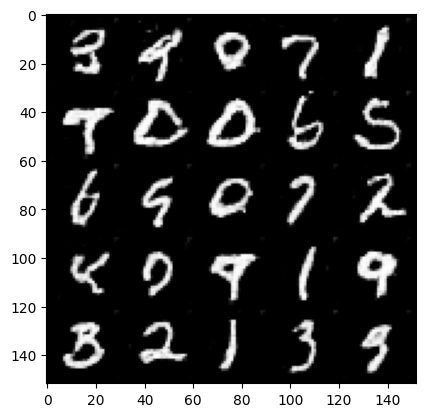

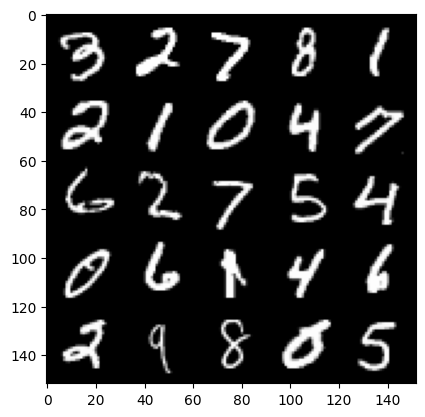

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 28: Step 17000: Generator loss: 0.7116400974988939, discriminator loss: 0.6985773791074749


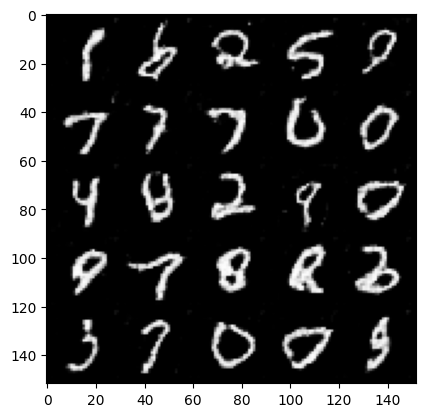

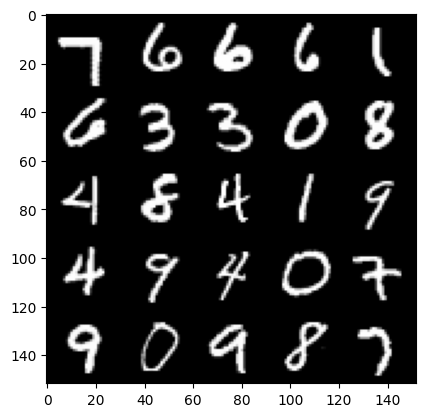

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 29: Step 17500: Generator loss: 0.7143287310600288, discriminator loss: 0.6984243150949476


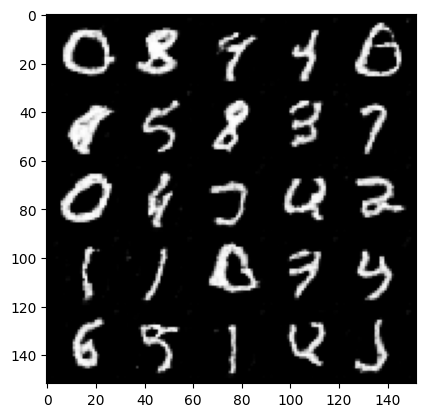

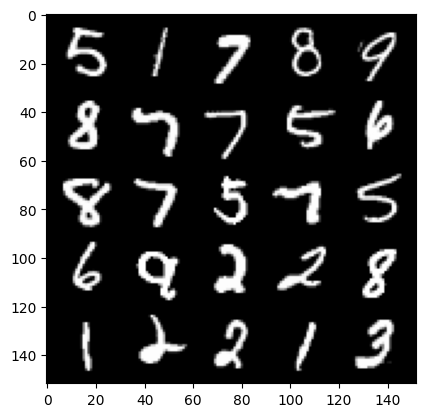

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 30: Step 18000: Generator loss: 0.7124405472278602, discriminator loss: 0.6989021562337874


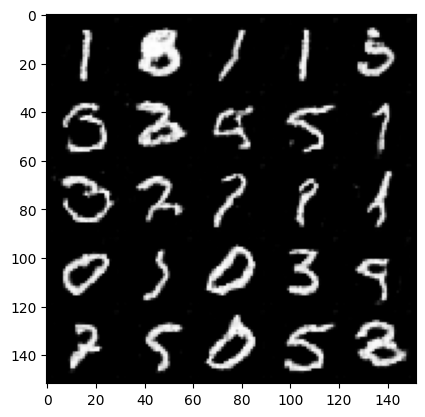

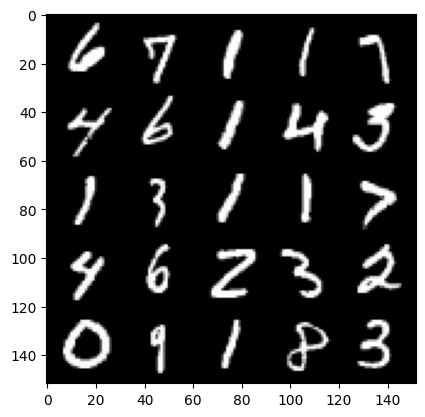

Epoch: 30: Step 18500: Generator loss: 0.7089351959228518, discriminator loss: 0.6991716380119327


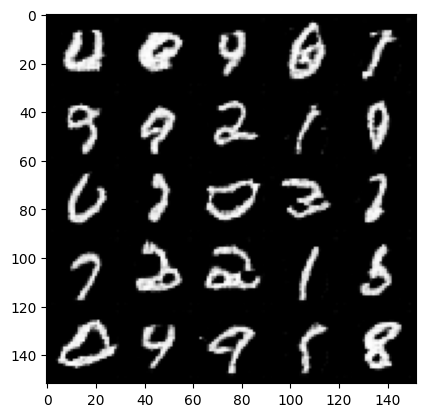

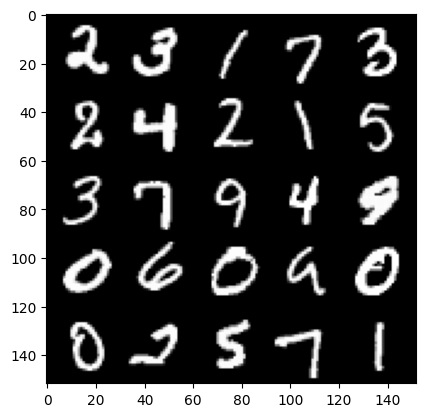

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 31: Step 19000: Generator loss: 0.7088188921213149, discriminator loss: 0.6997986451387409


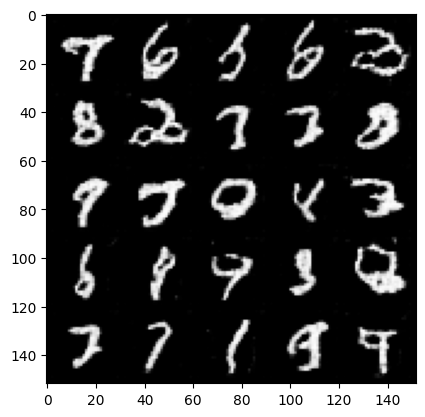

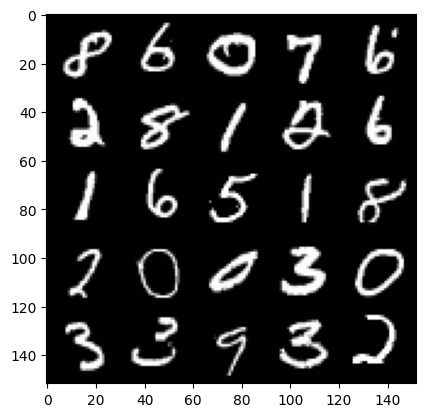

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 32: Step 19500: Generator loss: 0.7083023869991306, discriminator loss: 0.6996425070762633


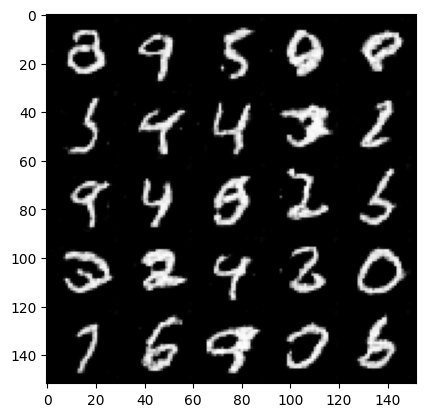

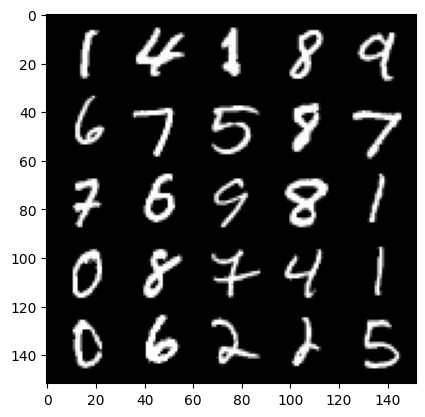

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 33: Step 20000: Generator loss: 0.7077054831981652, discriminator loss: 0.6992120934724804


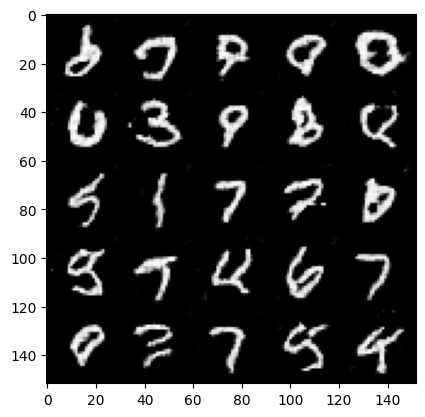

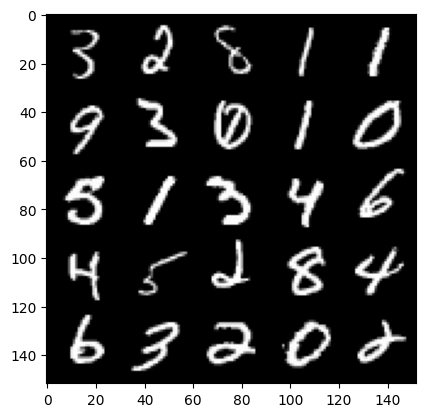

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 34: Step 20500: Generator loss: 0.7035174262523649, discriminator loss: 0.6983319160938266


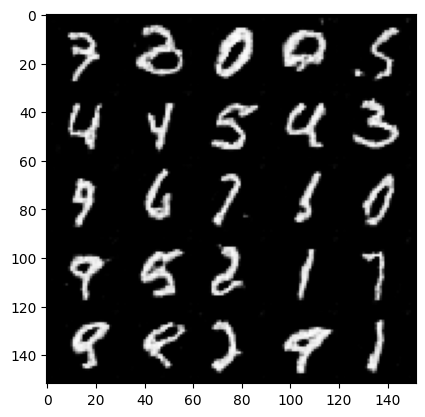

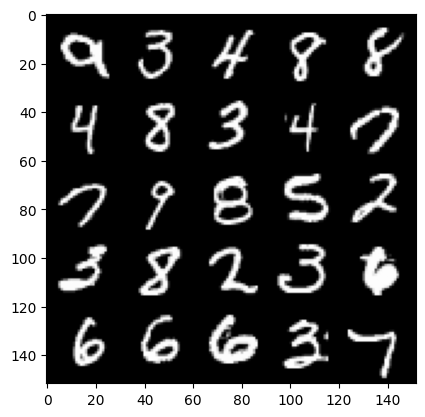

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 35: Step 21000: Generator loss: 0.7037322908639916, discriminator loss: 0.6987921473979946


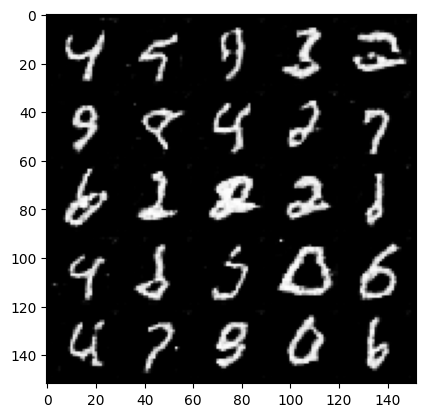

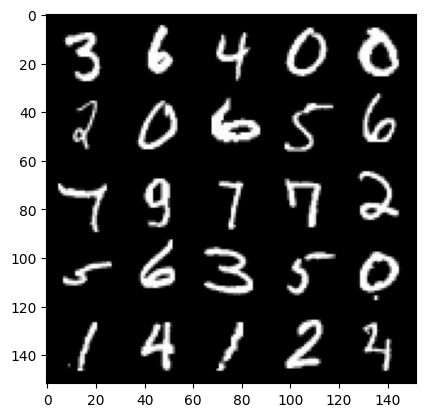

Epoch: 35: Step 21500: Generator loss: 0.7007615017890925, discriminator loss: 0.6984843596220007


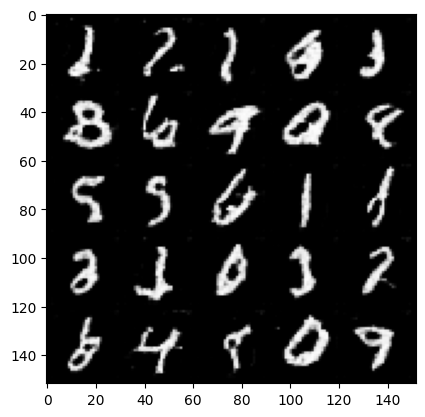

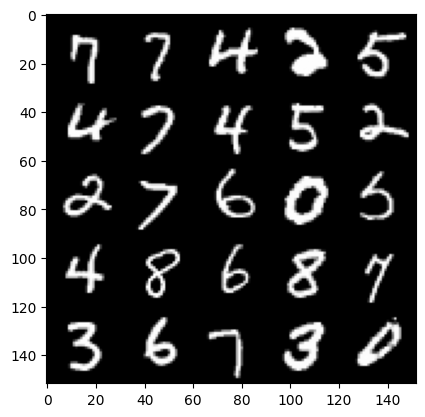

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 36: Step 22000: Generator loss: 0.7038608208894733, discriminator loss: 0.6979588701725004


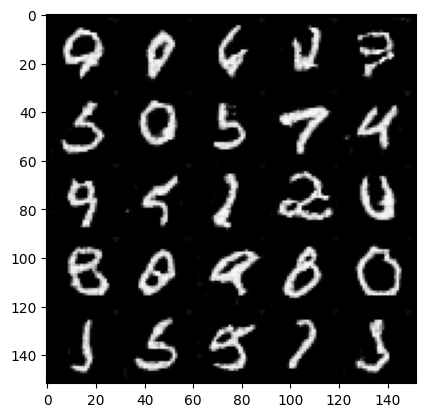

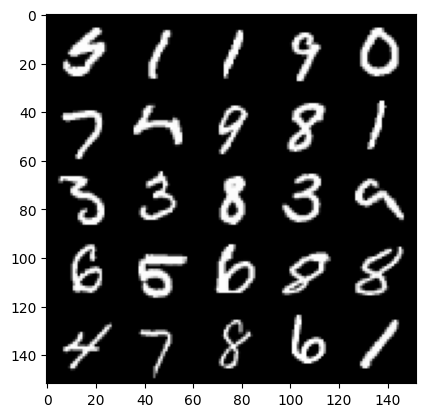

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 37: Step 22500: Generator loss: 0.6978455476760862, discriminator loss: 0.6977531428337097


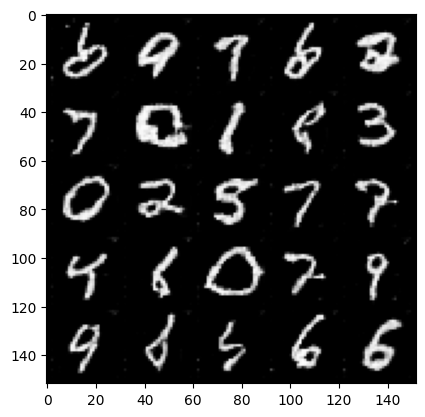

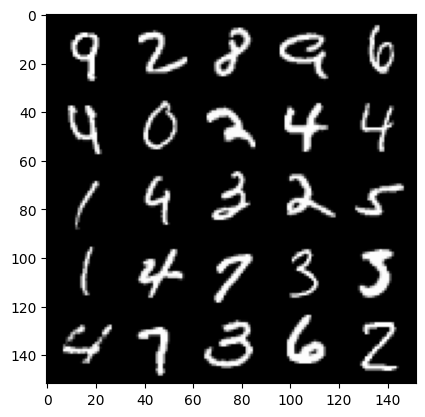

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 38: Step 23000: Generator loss: 0.7021976321935648, discriminator loss: 0.6978584823608399


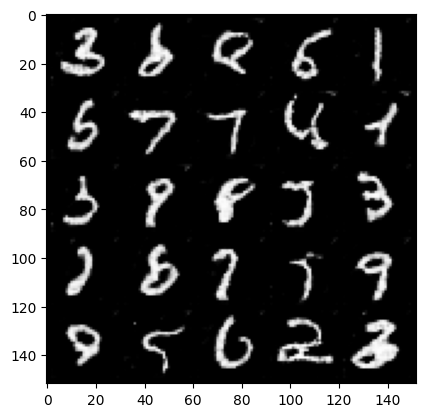

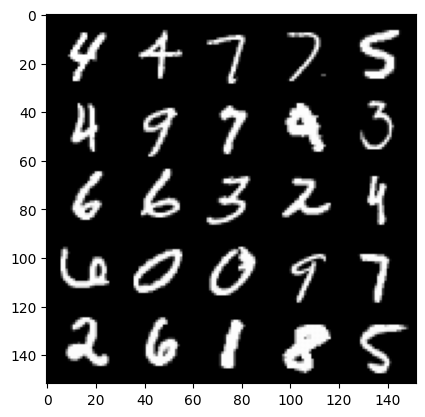

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 39: Step 23500: Generator loss: 0.7015658999681473, discriminator loss: 0.697377788066865


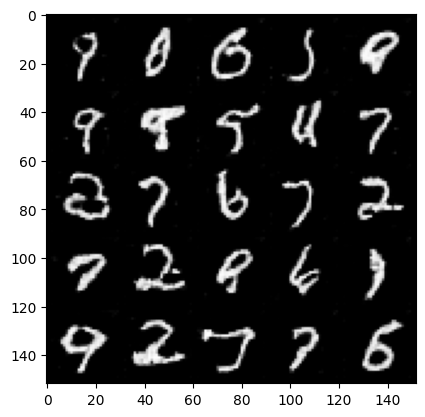

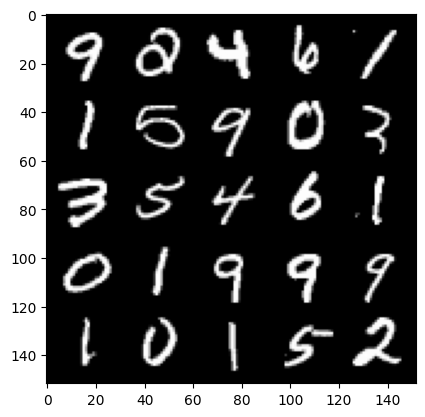

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 40: Step 24000: Generator loss: 0.6980625439882275, discriminator loss: 0.6968819540739059


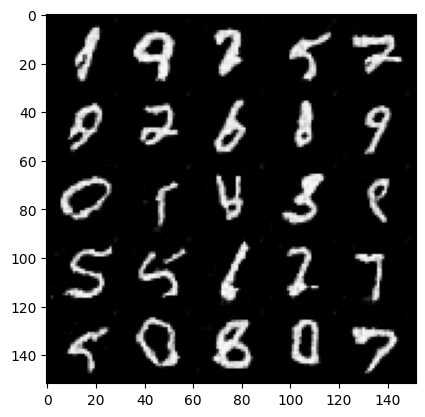

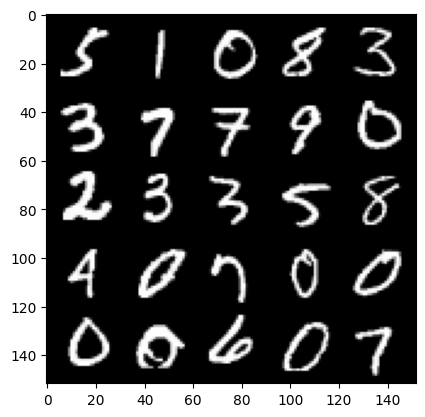

Epoch: 40: Step 24500: Generator loss: 0.7016766968965527, discriminator loss: 0.6972314741611478


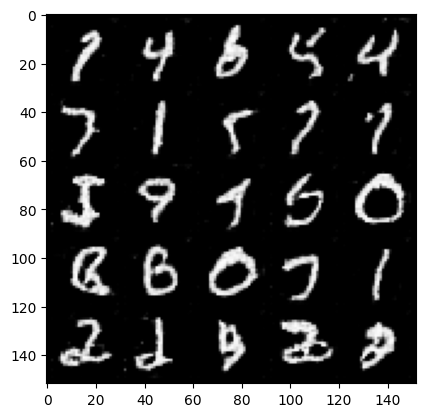

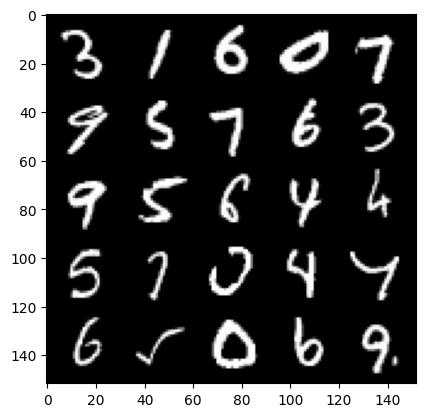

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 41: Step 25000: Generator loss: 0.6981969724893573, discriminator loss: 0.6962601910829549


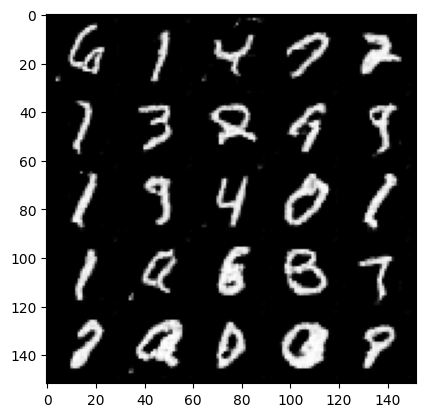

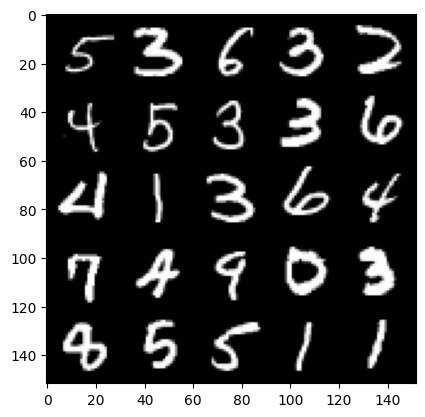

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 42: Step 25500: Generator loss: 0.6984094654321665, discriminator loss: 0.6961876560449594


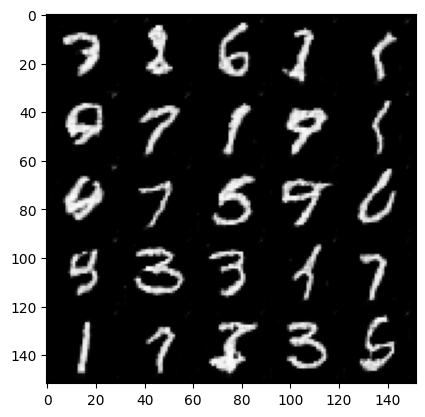

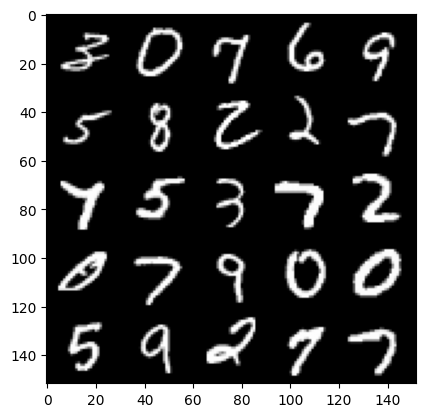

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 43: Step 26000: Generator loss: 0.6979031732082359, discriminator loss: 0.6960794014930722


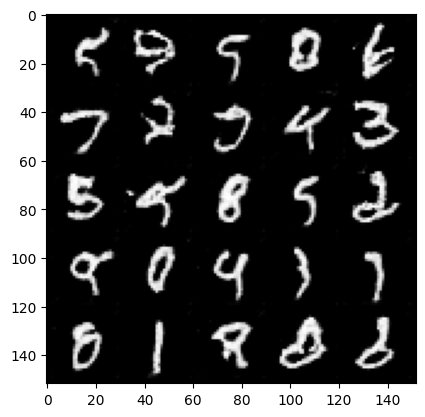

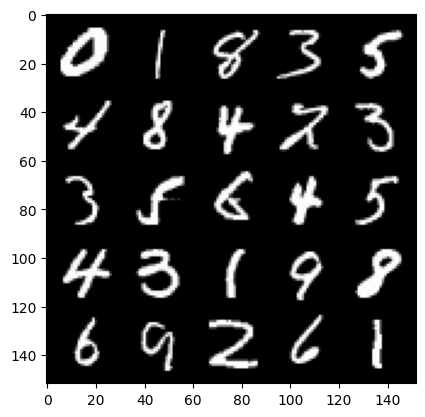

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 44: Step 26500: Generator loss: 0.7020486985445017, discriminator loss: 0.6959306454658507


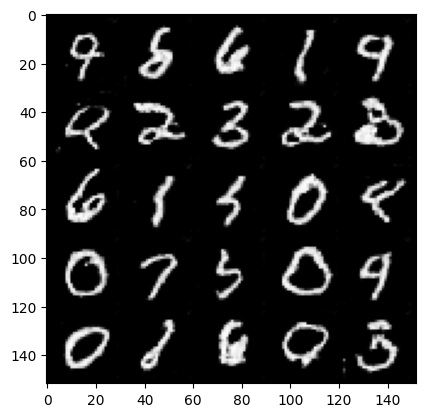

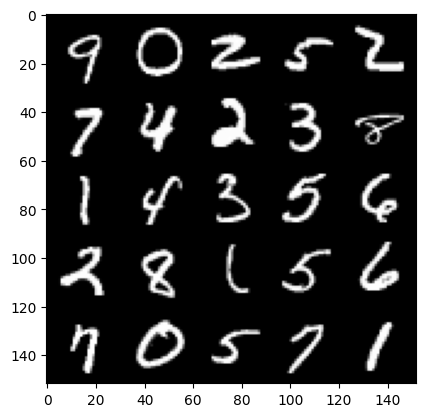

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 45: Step 27000: Generator loss: 0.6989091849327084, discriminator loss: 0.6957298028469083


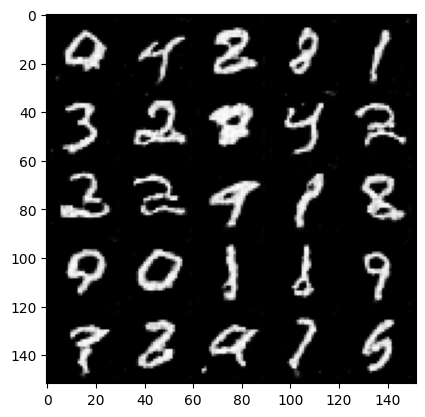

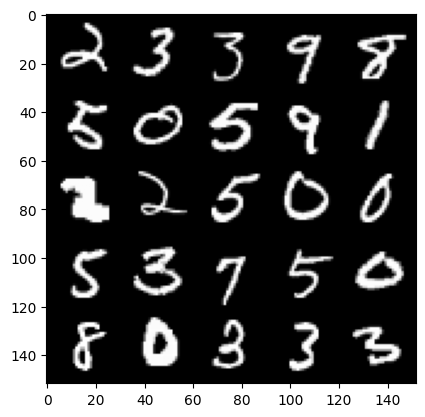

Epoch: 45: Step 27500: Generator loss: 0.6997686190605176, discriminator loss: 0.6958153040409084


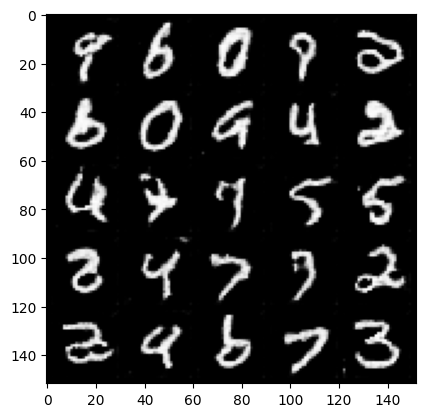

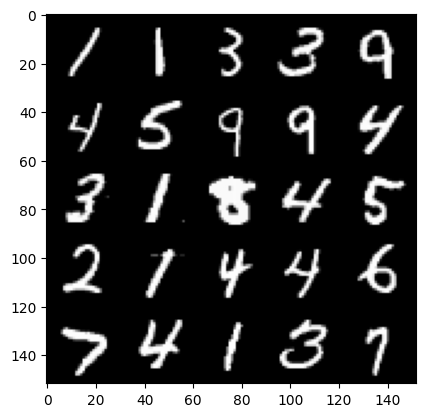

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 46: Step 28000: Generator loss: 0.6974513778686527, discriminator loss: 0.6954185087680815


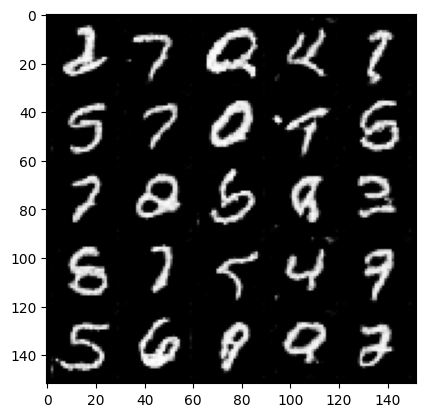

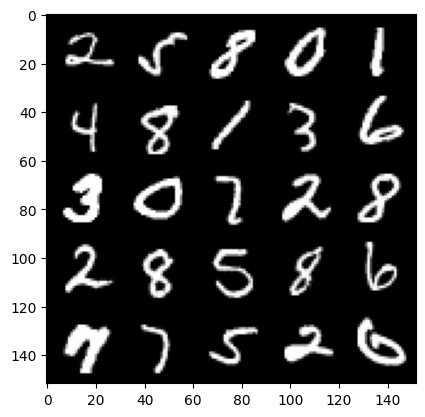

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 47: Step 28500: Generator loss: 0.6994437110424044, discriminator loss: 0.6953379517793654


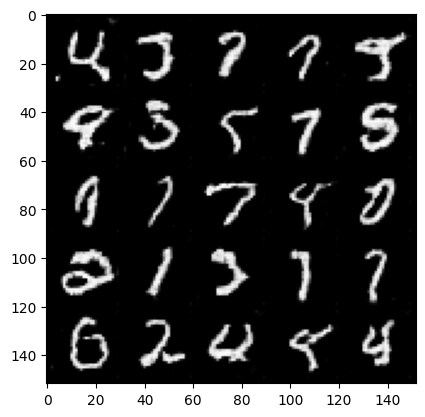

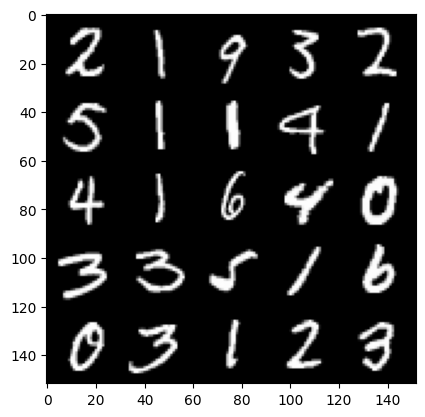

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 48: Step 29000: Generator loss: 0.6996891788244245, discriminator loss: 0.6954452016353605


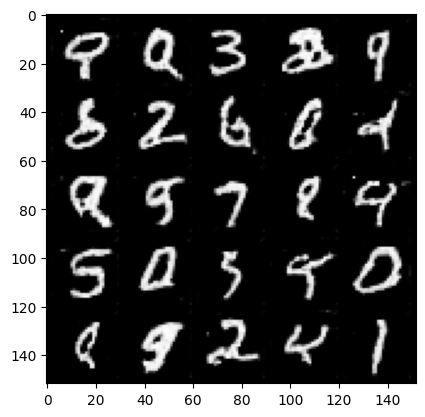

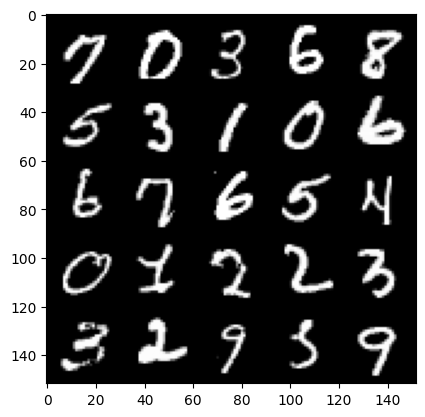

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 49: Step 29500: Generator loss: 0.6966499323844917, discriminator loss: 0.694879912018777


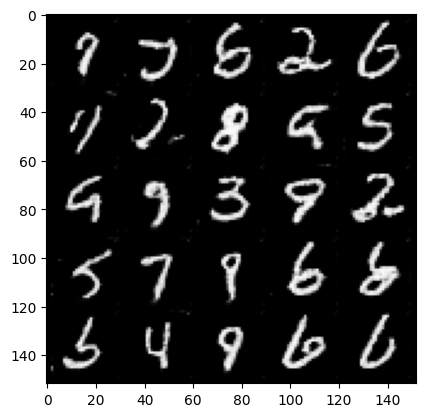

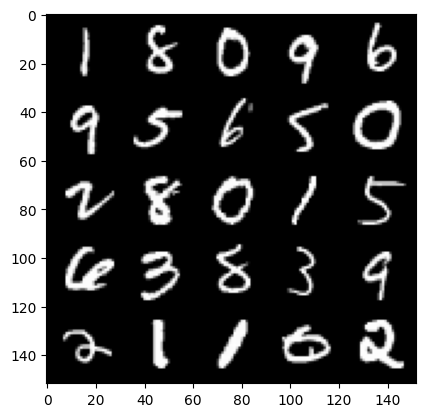

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 50: Step 30000: Generator loss: 0.697772590279579, discriminator loss: 0.6950210255384449


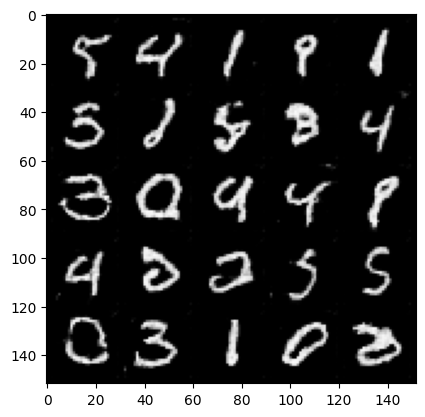

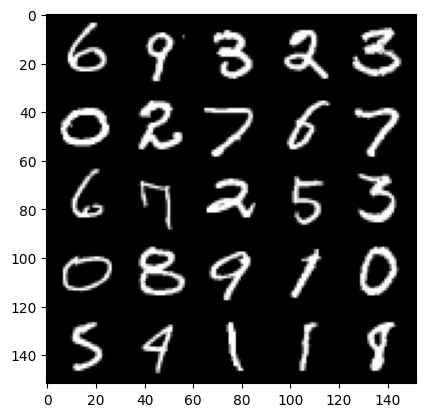

Epoch: 50: Step 30500: Generator loss: 0.6966258072853088, discriminator loss: 0.6947765446901322


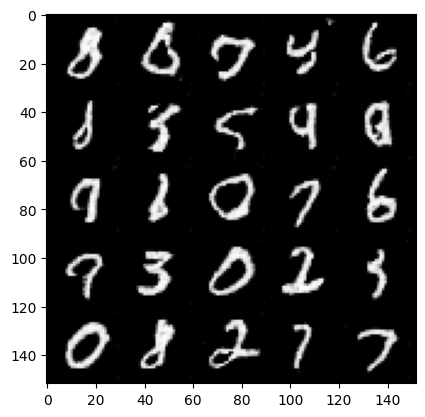

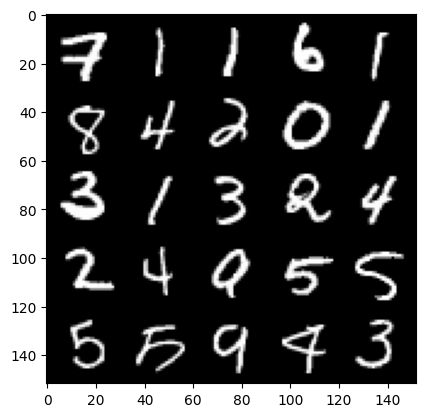

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 51: Step 31000: Generator loss: 0.6966267226934433, discriminator loss: 0.6948469859361649


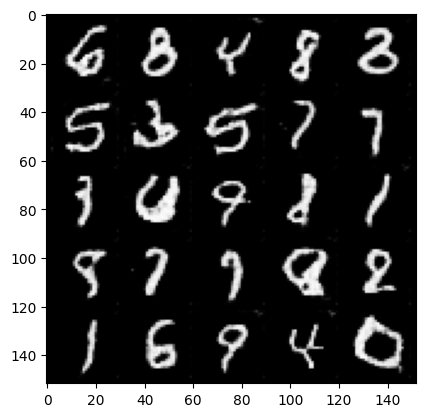

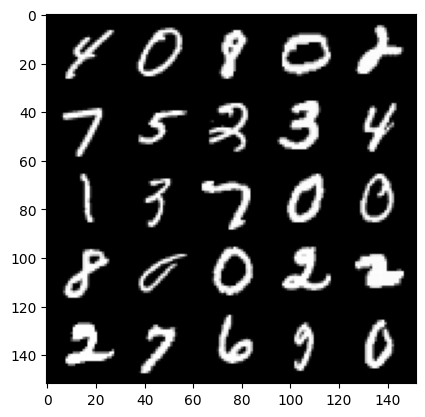

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 52: Step 31500: Generator loss: 0.6989098124504093, discriminator loss: 0.6951078158617023


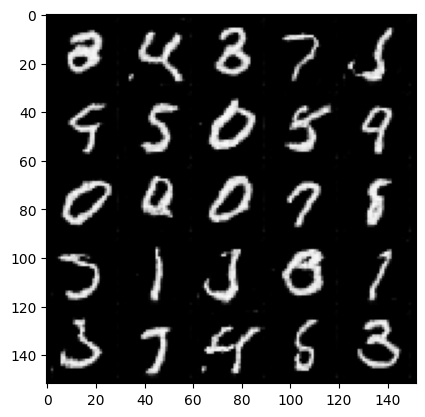

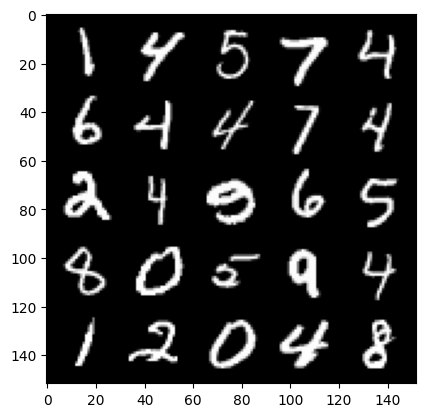

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 53: Step 32000: Generator loss: 0.6966868535280232, discriminator loss: 0.6946552586555483


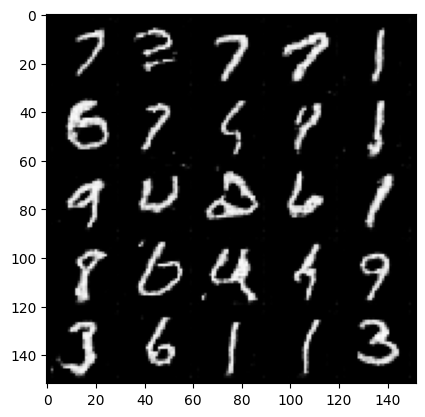

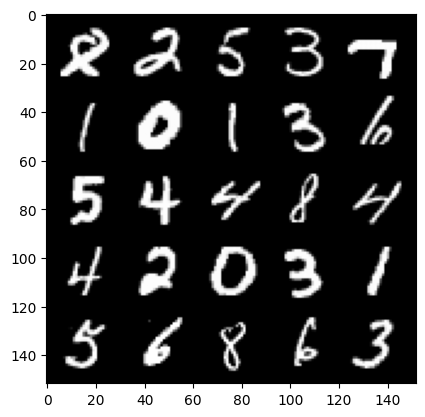

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 54: Step 32500: Generator loss: 0.6975658766031271, discriminator loss: 0.6947142205238351


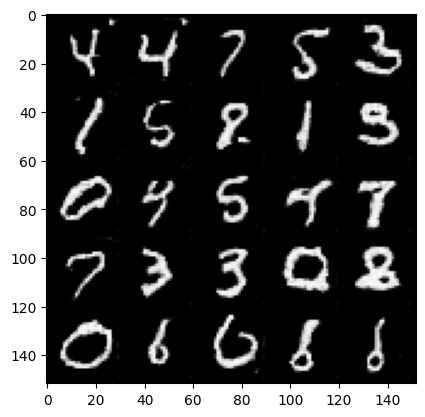

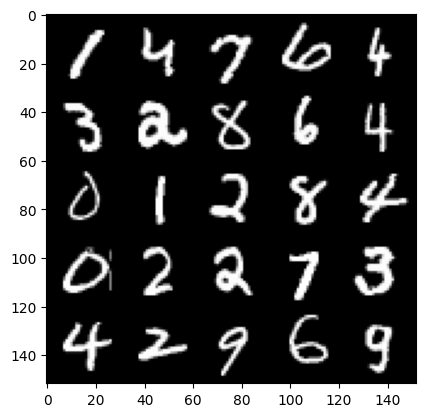

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 55: Step 33000: Generator loss: 0.6974105347394939, discriminator loss: 0.6944521733522421


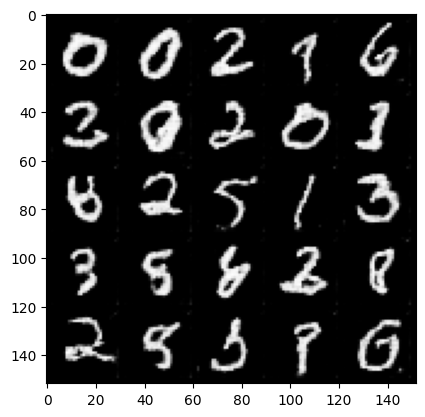

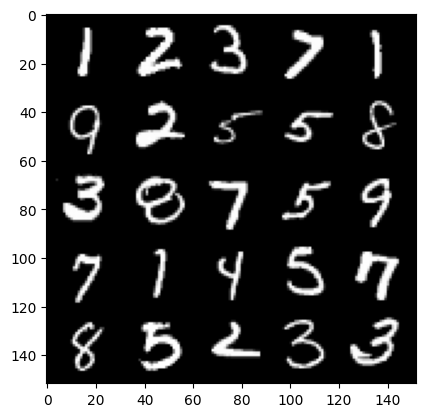

Epoch: 55: Step 33500: Generator loss: 0.6961822323799136, discriminator loss: 0.6944678497314454


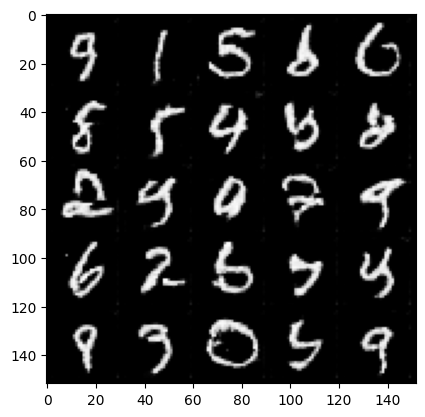

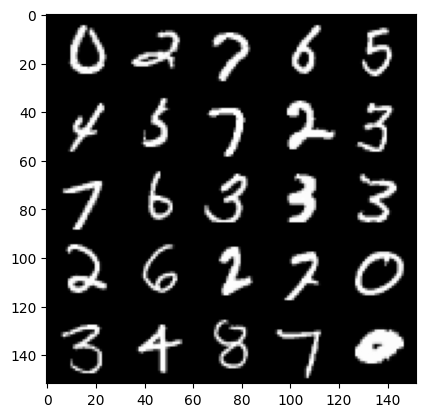

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 56: Step 34000: Generator loss: 0.6990569839477541, discriminator loss: 0.6949322910308835


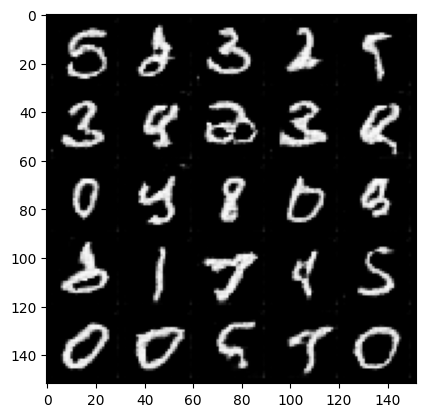

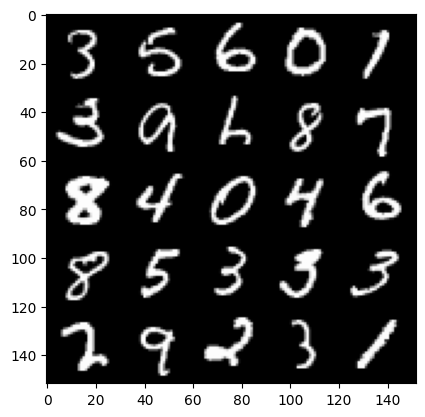

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 57: Step 34500: Generator loss: 0.697673278570175, discriminator loss: 0.6944985485076902


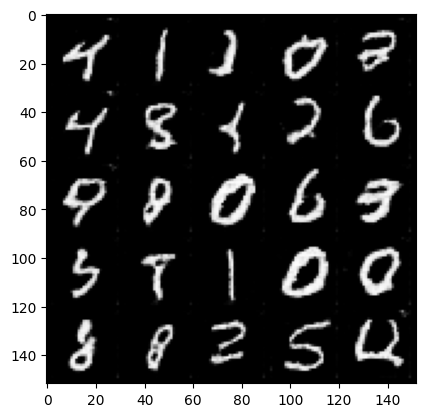

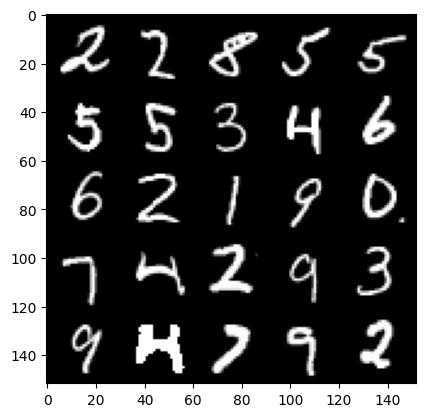

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 58: Step 35000: Generator loss: 0.6978383796215055, discriminator loss: 0.694361651182175


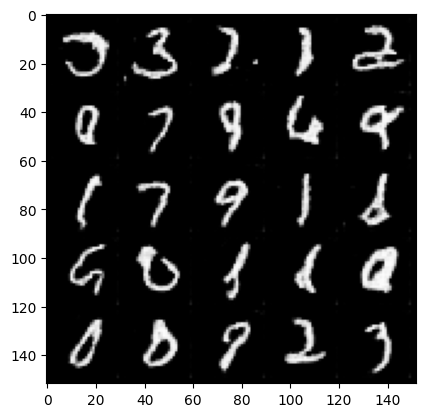

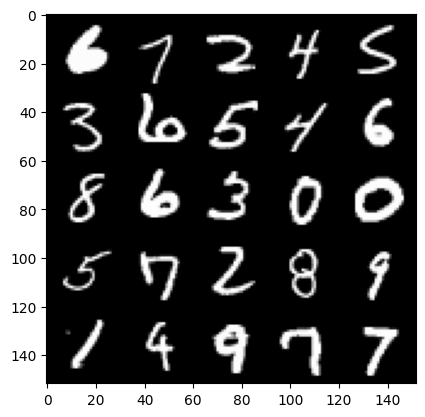

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 59: Step 35500: Generator loss: 0.6964821432828908, discriminator loss: 0.6942734632492065


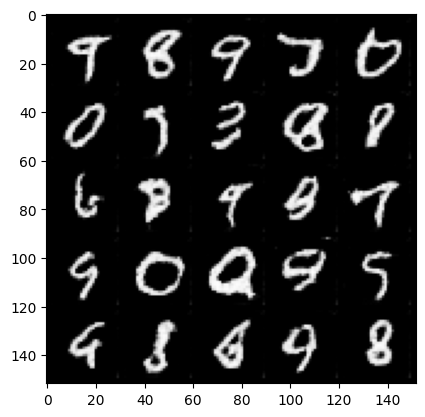

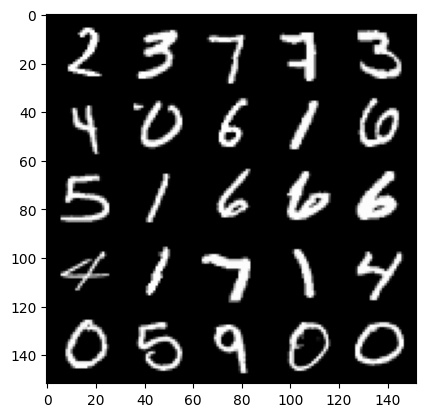

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 60: Step 36000: Generator loss: 0.6984116384983061, discriminator loss: 0.69445405626297


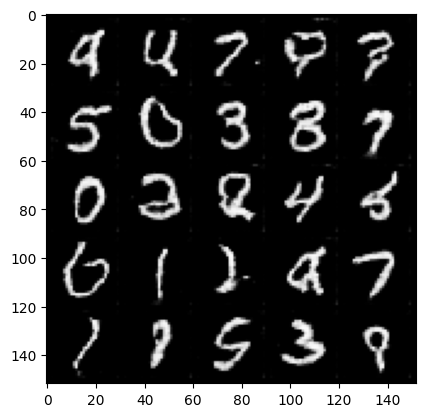

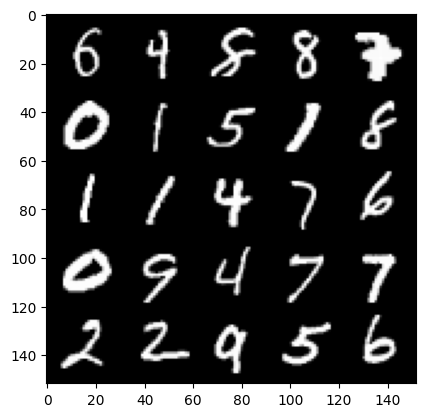

Epoch: 60: Step 36500: Generator loss: 0.6963478103876114, discriminator loss: 0.6946443762779232


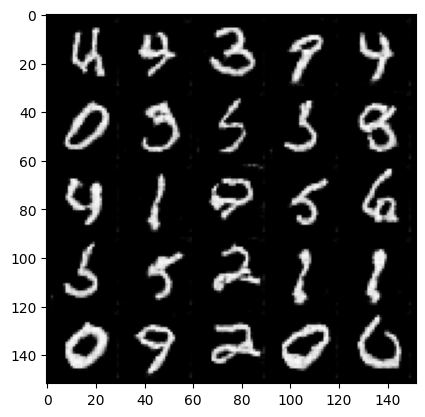

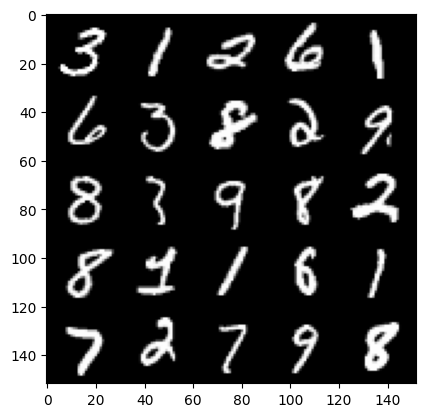

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 61: Step 37000: Generator loss: 0.6969833306074139, discriminator loss: 0.6943053206205371


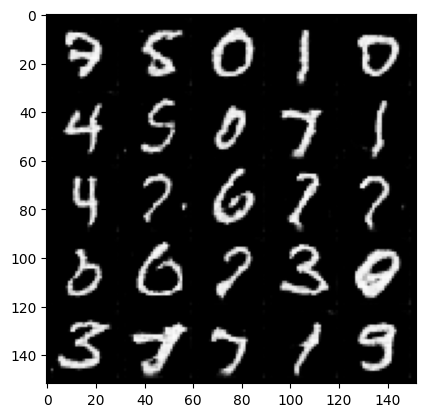

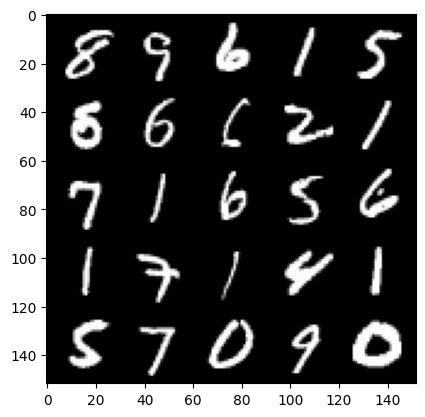

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 62: Step 37500: Generator loss: 0.6961453845500947, discriminator loss: 0.6942564008235932


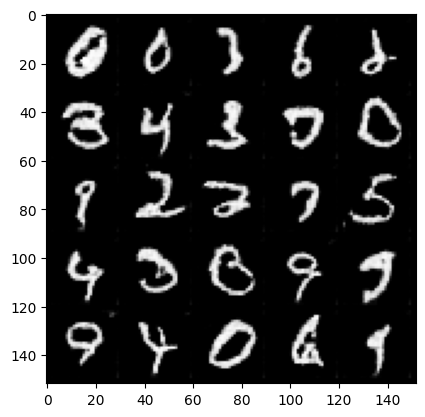

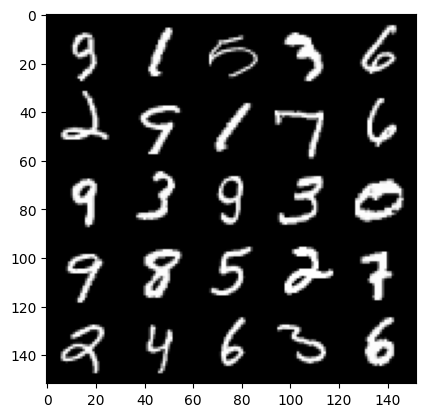

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 63: Step 38000: Generator loss: 0.6958637907505032, discriminator loss: 0.6943645924329757


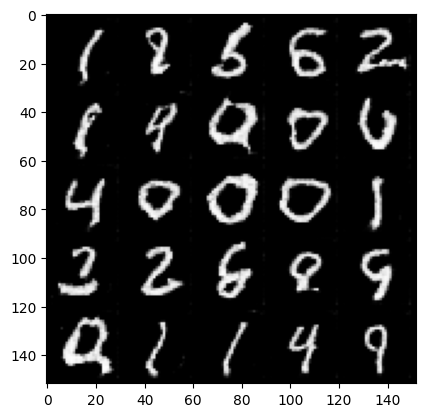

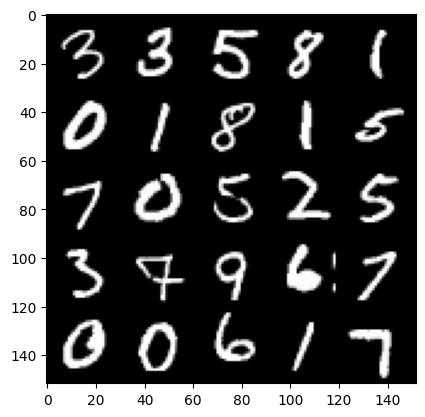

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 64: Step 38500: Generator loss: 0.6959993479251863, discriminator loss: 0.6944655585289005


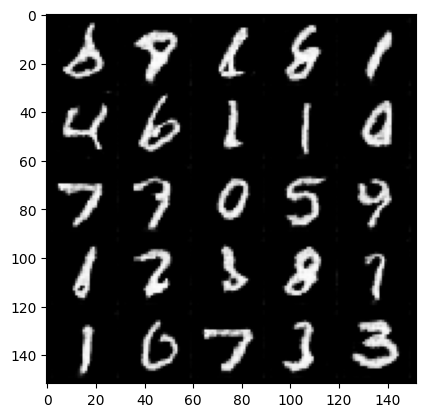

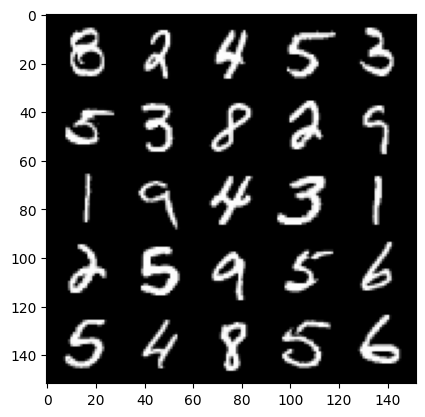

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 65: Step 39000: Generator loss: 0.6947923043966299, discriminator loss: 0.6942091645002373


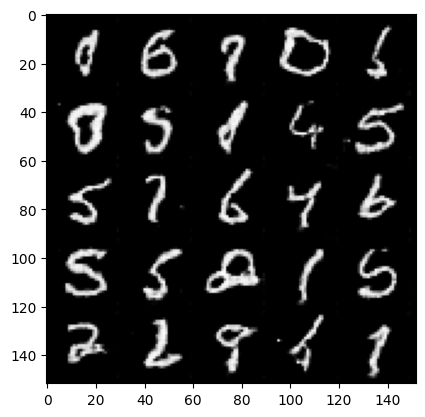

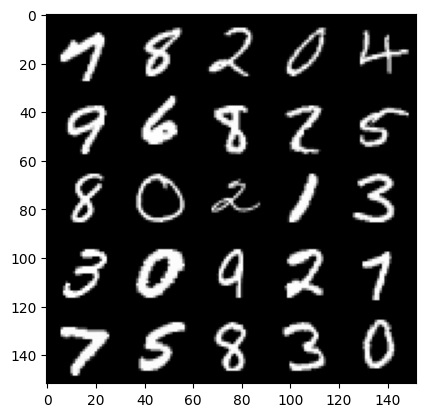

Epoch: 65: Step 39500: Generator loss: 0.698859047532082, discriminator loss: 0.694451836228371


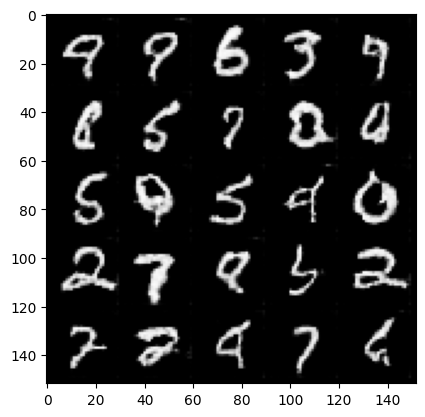

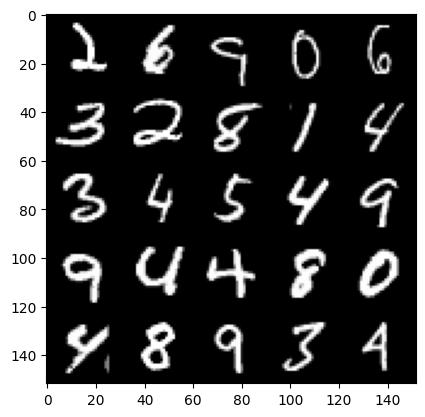

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 66: Step 40000: Generator loss: 0.6958621002435684, discriminator loss: 0.6944334940910337


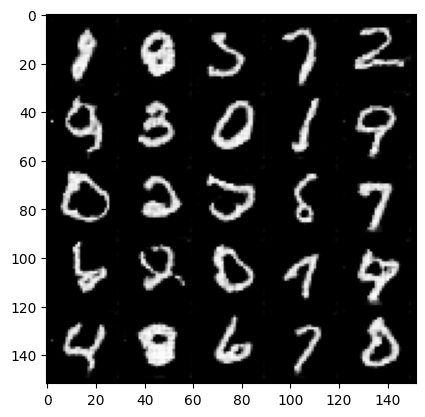

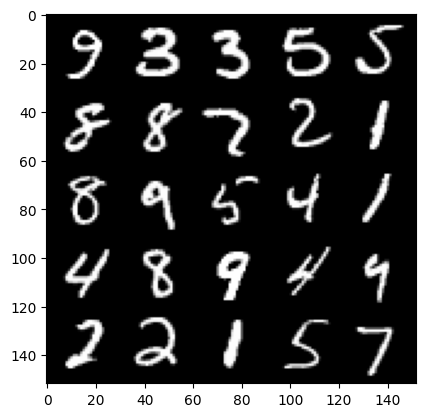

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 67: Step 40500: Generator loss: 0.6962579771280287, discriminator loss: 0.69433999812603


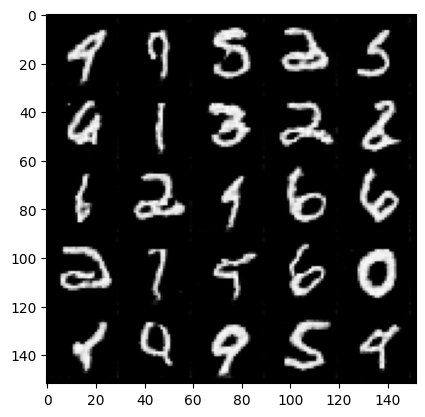

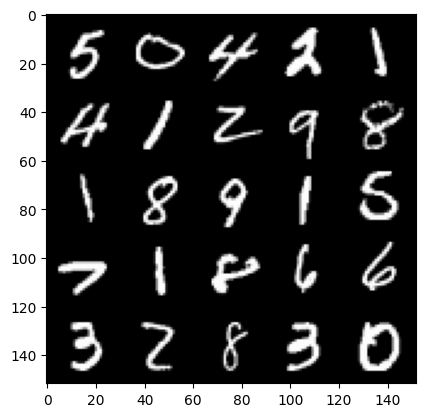

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 68: Step 41000: Generator loss: 0.695370243549347, discriminator loss: 0.6942690832614901


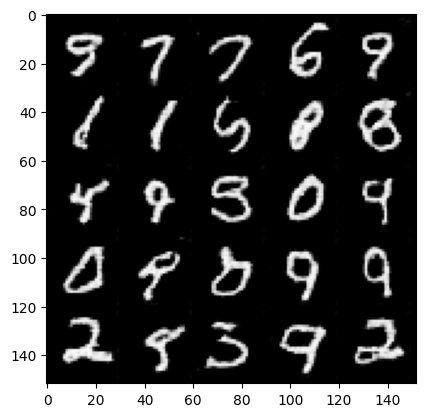

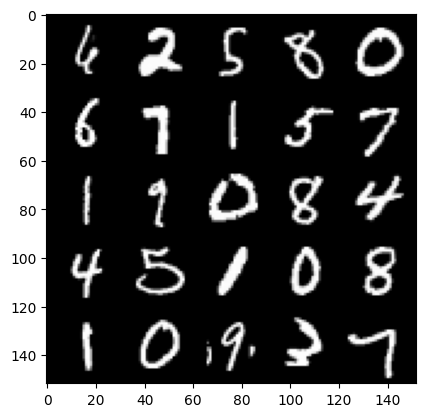

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 69: Step 41500: Generator loss: 0.6954247732162468, discriminator loss: 0.6941144396066665


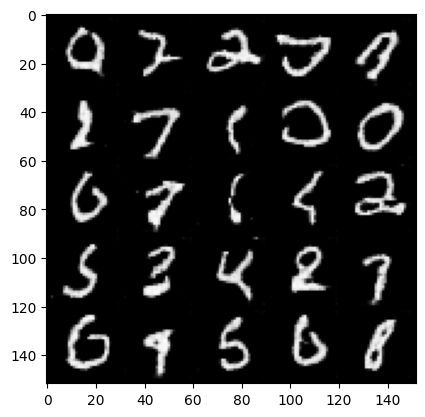

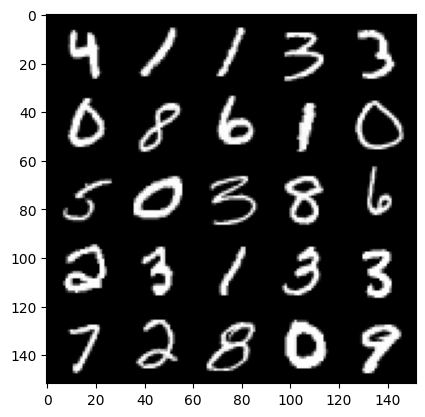

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 70: Step 42000: Generator loss: 0.6956926544904704, discriminator loss: 0.6941751199960711


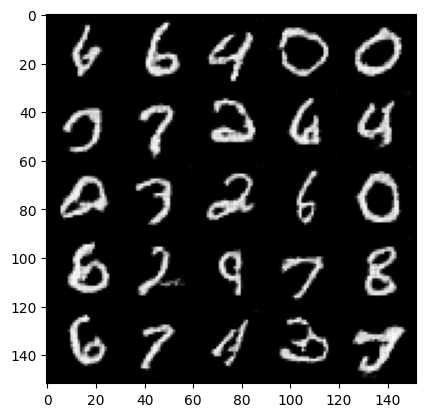

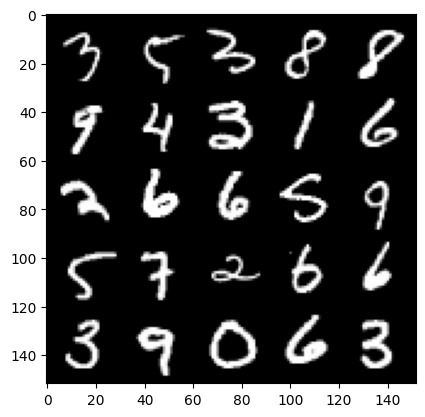

Epoch: 70: Step 42500: Generator loss: 0.6953570362329489, discriminator loss: 0.694224095225334


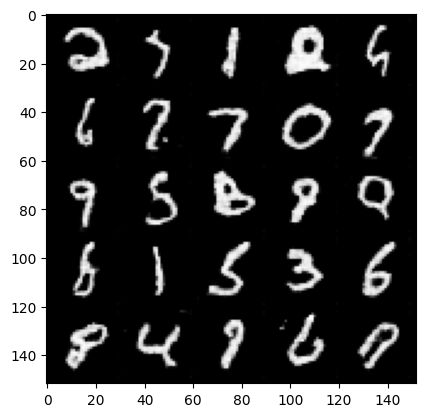

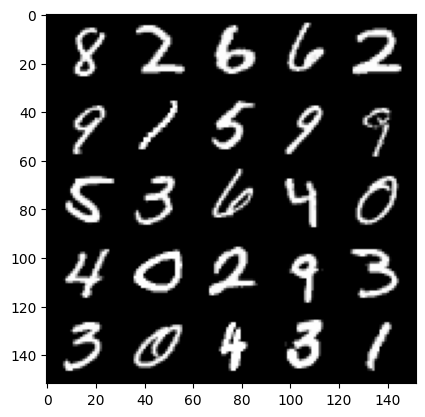

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 71: Step 43000: Generator loss: 0.6952543448209761, discriminator loss: 0.6941712402105337


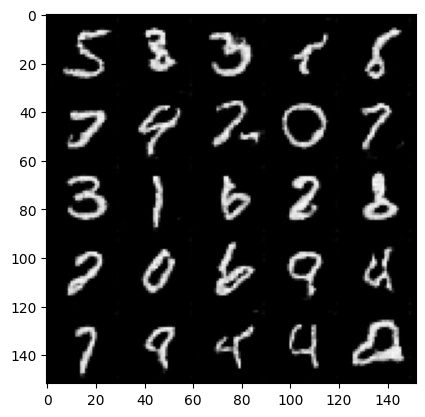

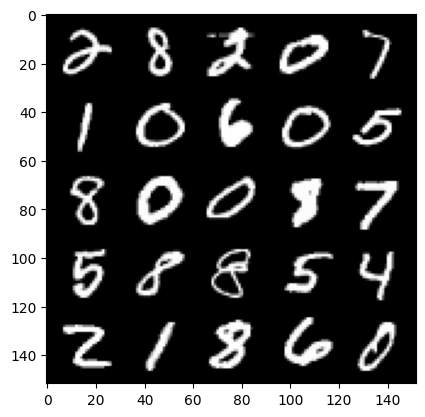

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 72: Step 43500: Generator loss: 0.6955722690820696, discriminator loss: 0.6942139879465101


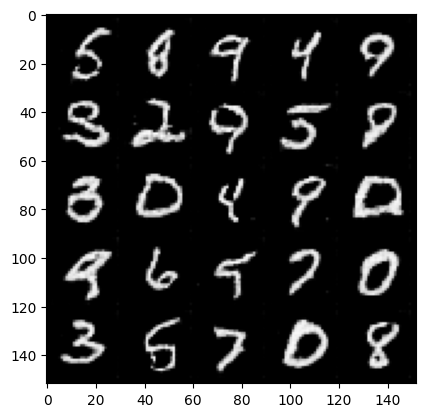

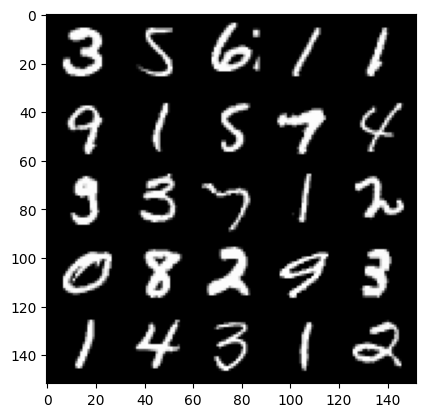

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 73: Step 44000: Generator loss: 0.6957213546037674, discriminator loss: 0.6941761521100996


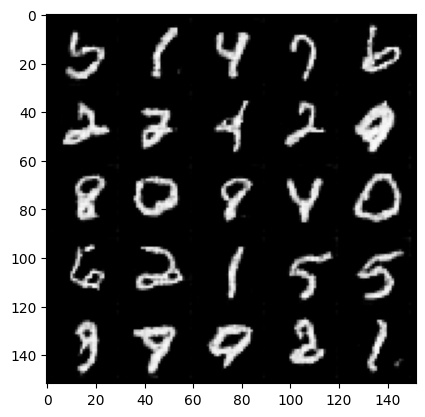

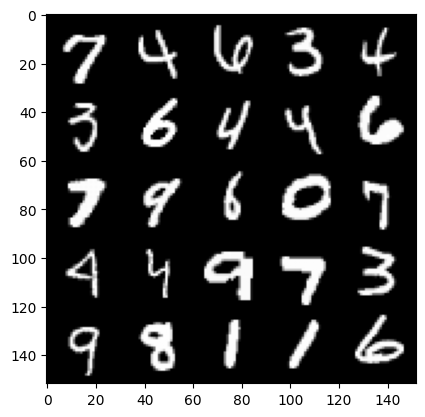

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 74: Step 44500: Generator loss: 0.6954120166301728, discriminator loss: 0.6942637357711796


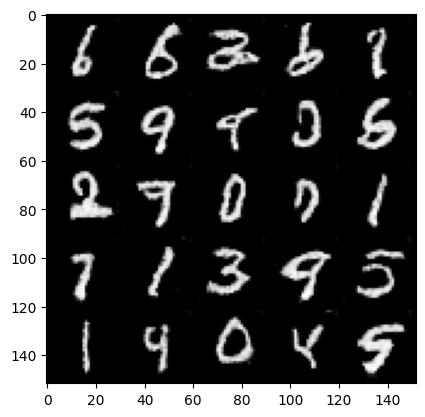

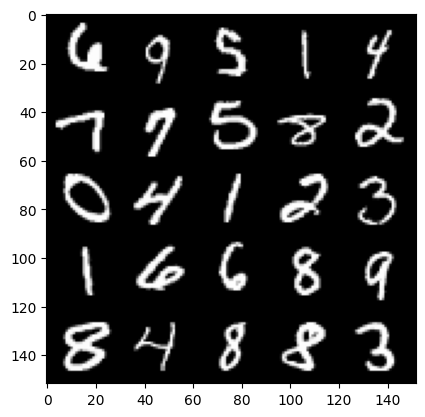

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 75: Step 45000: Generator loss: 0.6954129954576492, discriminator loss: 0.694052868247032


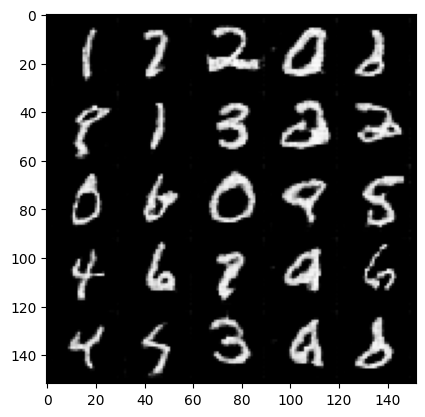

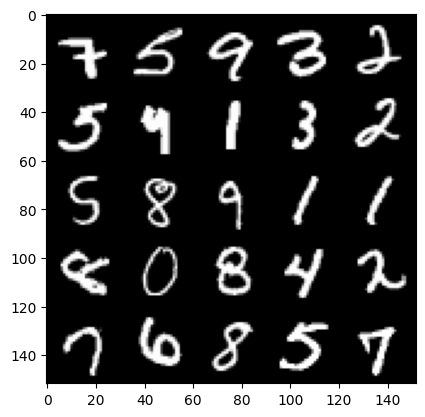

Epoch: 75: Step 45500: Generator loss: 0.6956941289901732, discriminator loss: 0.6938968721628194


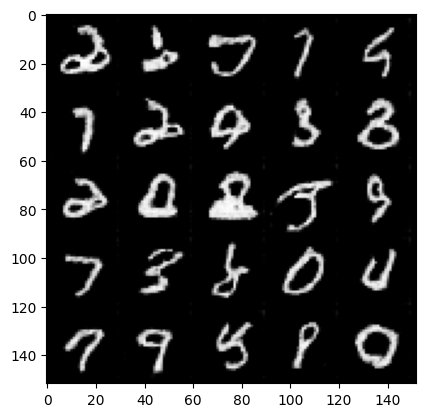

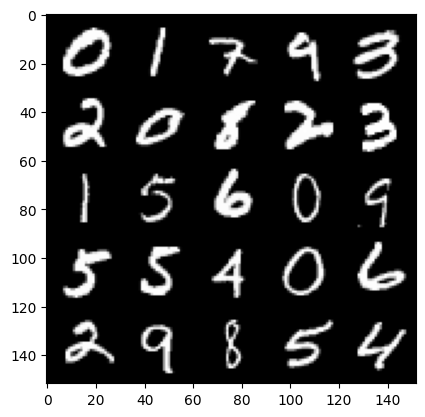

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 76: Step 46000: Generator loss: 0.6938009206056596, discriminator loss: 0.694075221657753


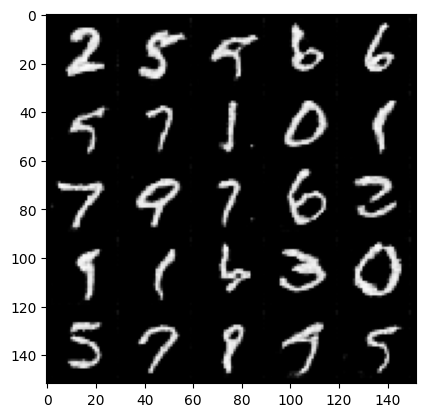

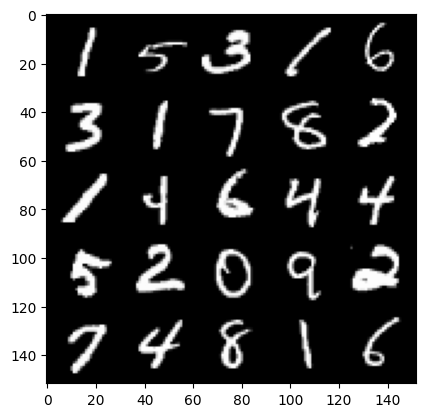

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 77: Step 46500: Generator loss: 0.6959872176647189, discriminator loss: 0.69421553683281


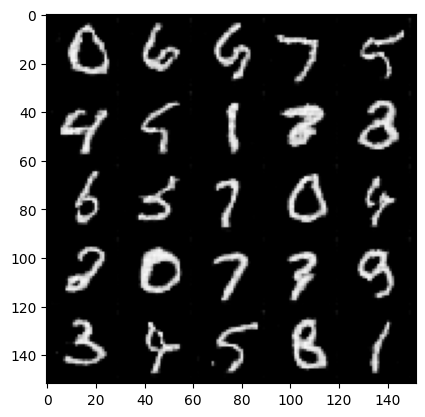

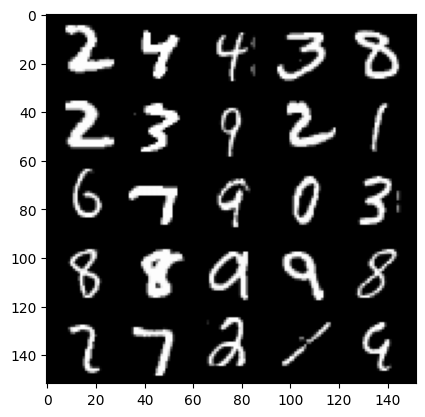

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 78: Step 47000: Generator loss: 0.6946900677680973, discriminator loss: 0.6938234237432479


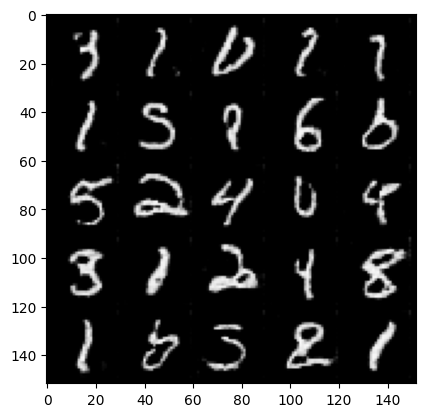

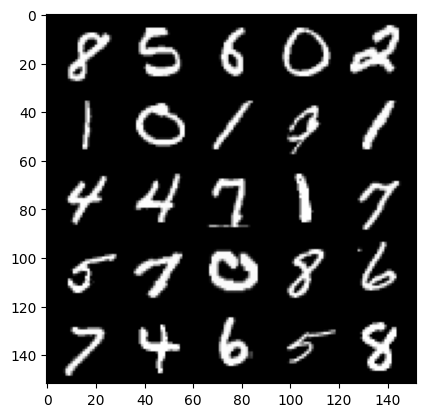

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 79: Step 47500: Generator loss: 0.6957500497102735, discriminator loss: 0.6940499203205109


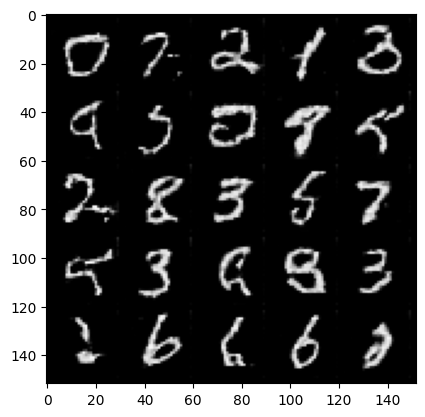

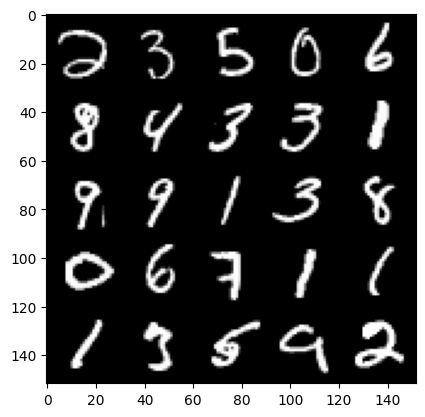

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 80: Step 48000: Generator loss: 0.6956349296569833, discriminator loss: 0.6939669749736792


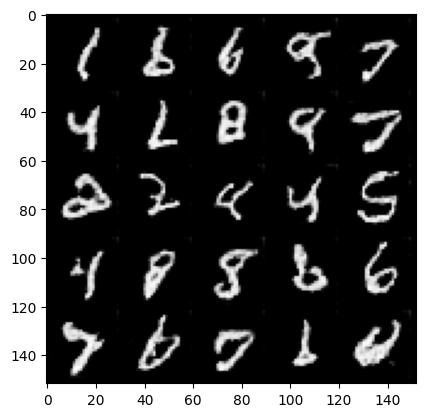

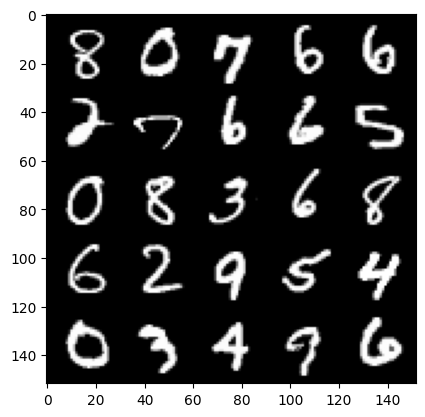

Epoch: 80: Step 48500: Generator loss: 0.6940349885225292, discriminator loss: 0.694095066666603


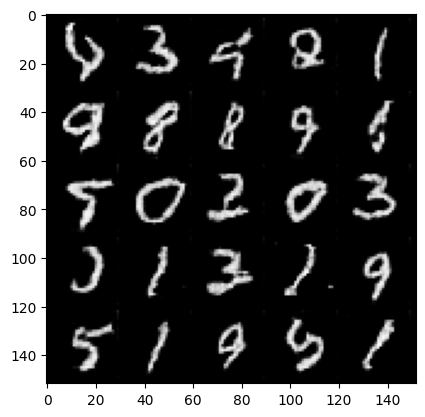

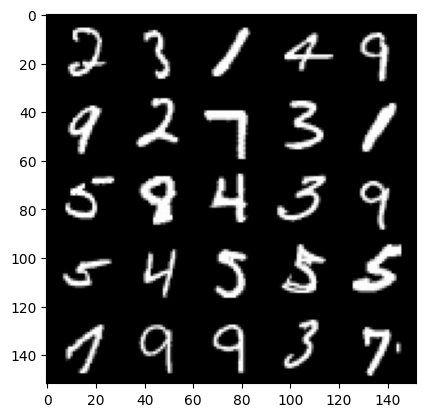

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 81: Step 49000: Generator loss: 0.6952873085737233, discriminator loss: 0.6940184491872794


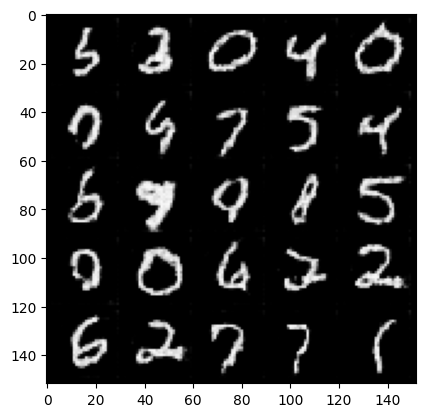

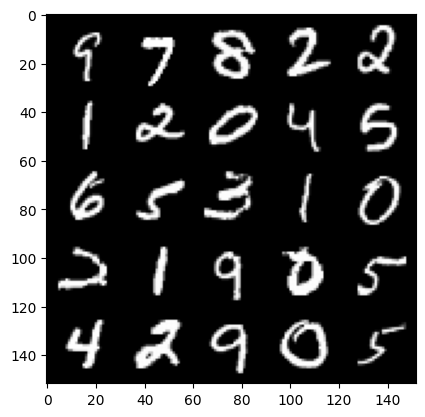

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 82: Step 49500: Generator loss: 0.6942010767459875, discriminator loss: 0.6940411196947099


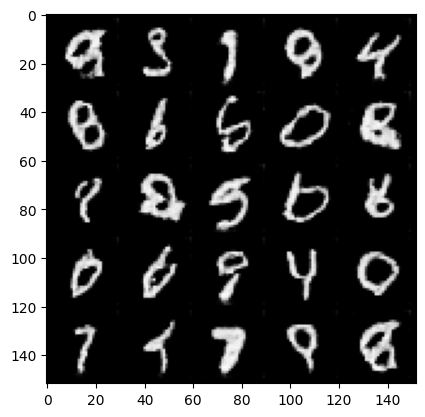

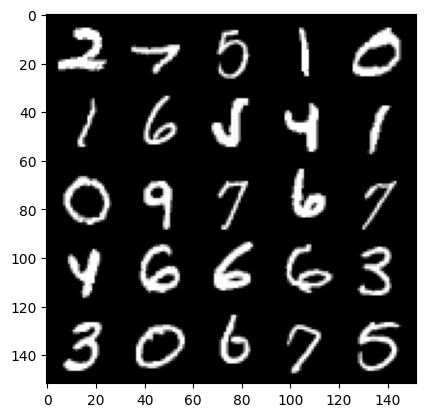

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 83: Step 50000: Generator loss: 0.6938293416500093, discriminator loss: 0.6938492873907094


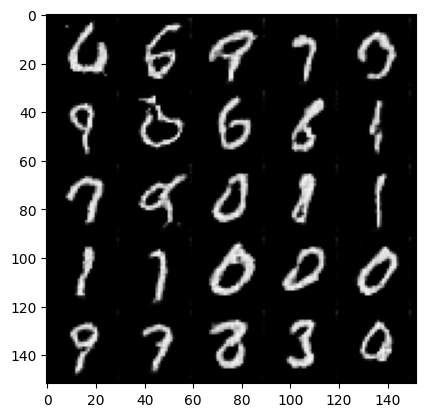

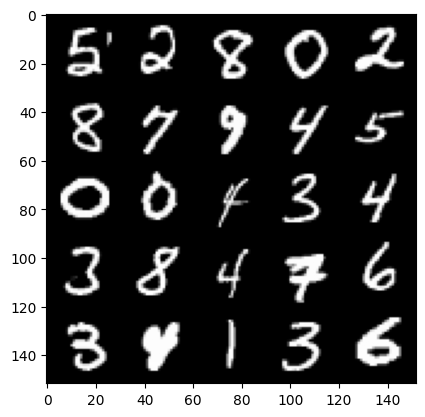

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 84: Step 50500: Generator loss: 0.6959403135776515, discriminator loss: 0.6939299650192267


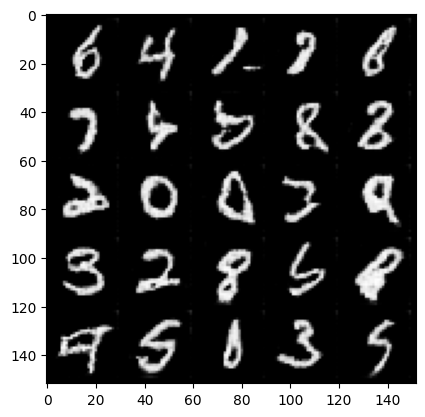

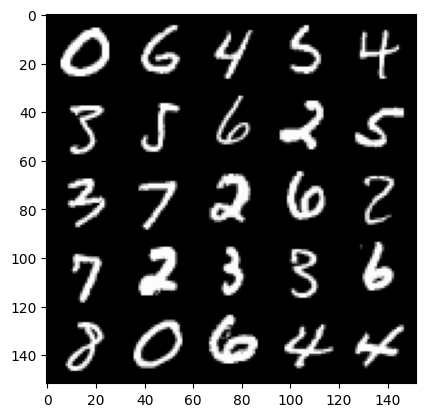

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 85: Step 51000: Generator loss: 0.693891467809677, discriminator loss: 0.6938840523958203


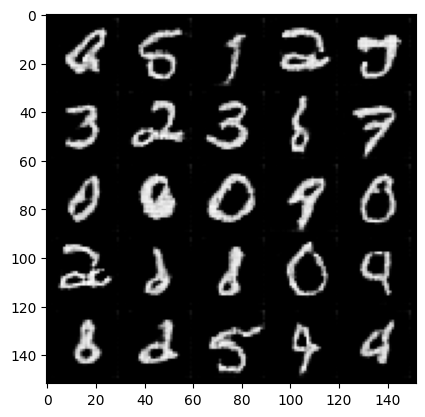

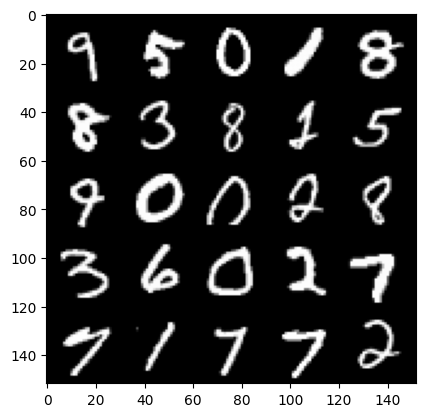

Epoch: 85: Step 51500: Generator loss: 0.6948833414316175, discriminator loss: 0.6939262095689779


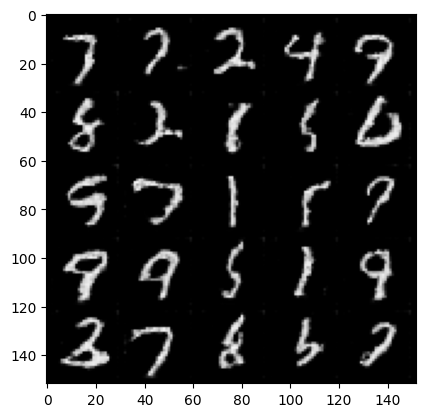

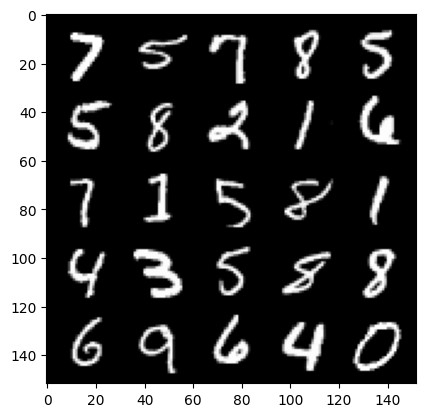

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 86: Step 52000: Generator loss: 0.6950911682844158, discriminator loss: 0.6939093922376629


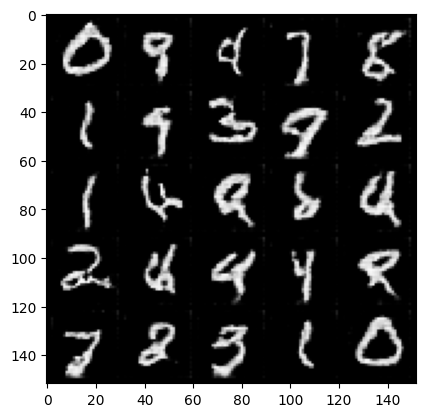

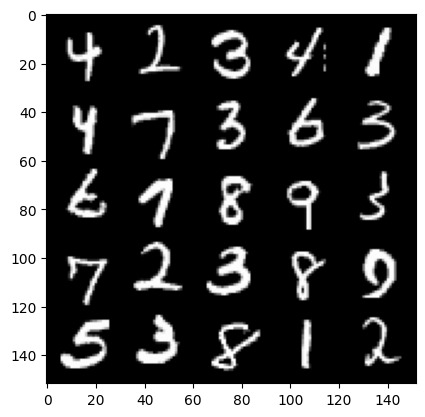

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 87: Step 52500: Generator loss: 0.6940906777381893, discriminator loss: 0.6937039915323261


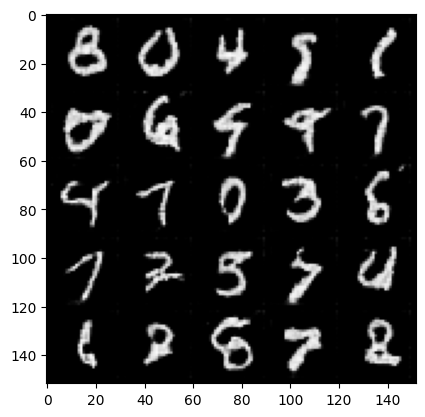

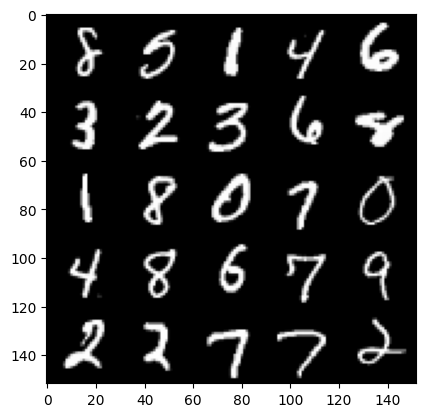

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 88: Step 53000: Generator loss: 0.6951266757249832, discriminator loss: 0.6937587183713915


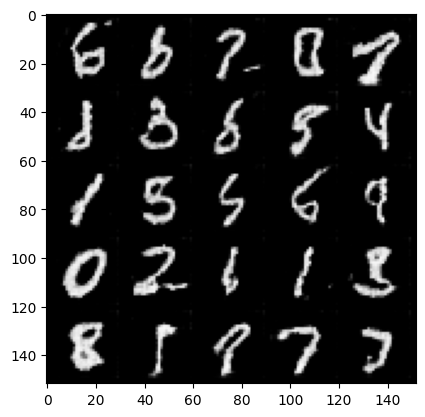

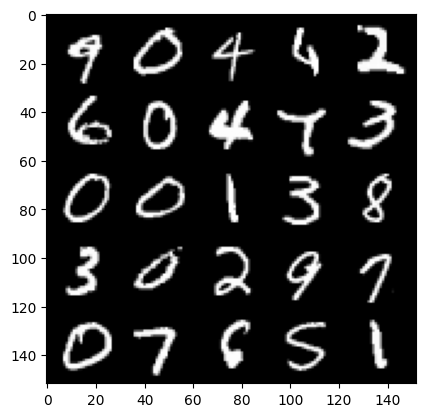

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 89: Step 53500: Generator loss: 0.6941269849538799, discriminator loss: 0.6938082494735727


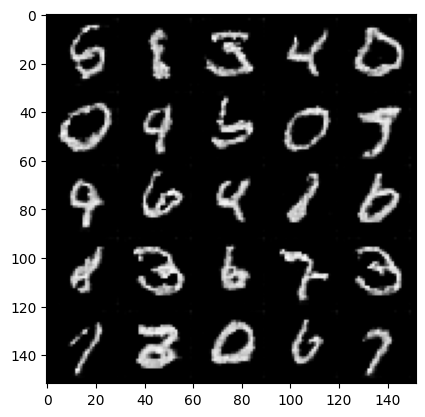

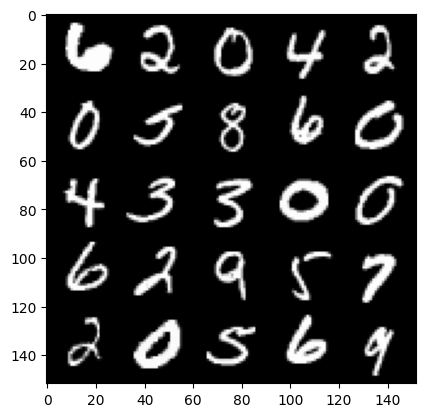

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 90: Step 54000: Generator loss: 0.6943690134286881, discriminator loss: 0.6939916630983356


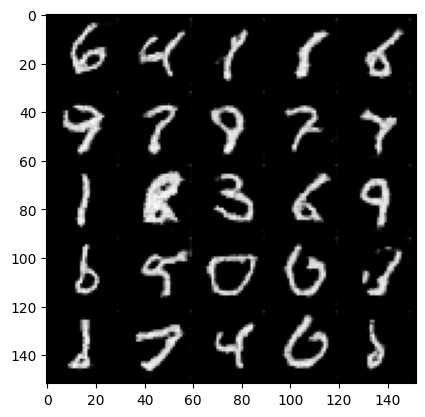

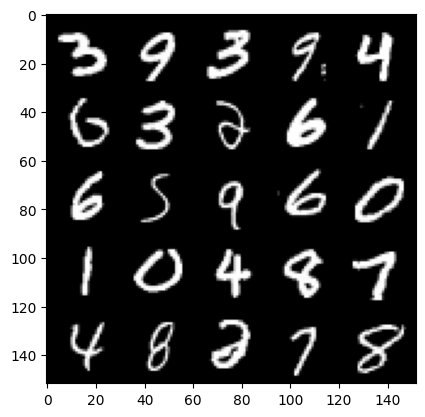

Epoch: 90: Step 54500: Generator loss: 0.6947135752439499, discriminator loss: 0.6937164399623871


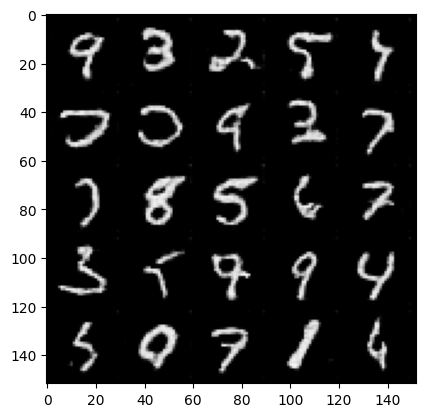

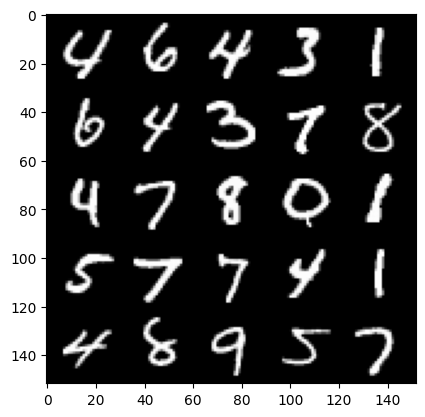

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 91: Step 55000: Generator loss: 0.6953374865055075, discriminator loss: 0.6938416978120817


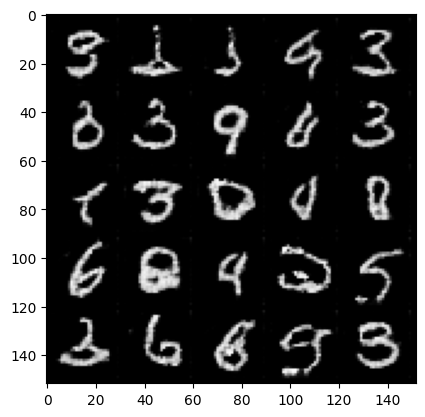

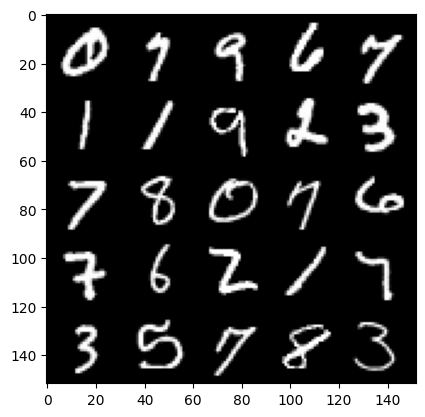

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 92: Step 55500: Generator loss: 0.6938728387355803, discriminator loss: 0.6937922009229661


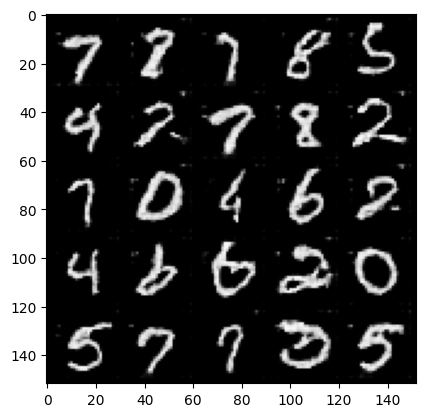

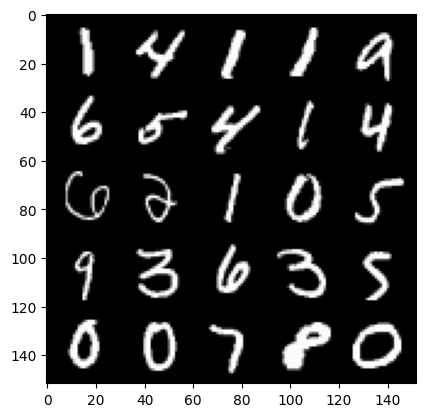

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 93: Step 56000: Generator loss: 0.6948159278631215, discriminator loss: 0.6936434681415561


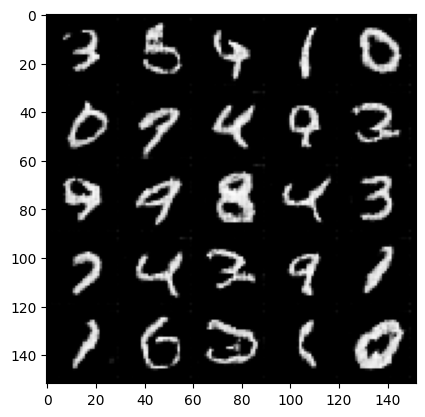

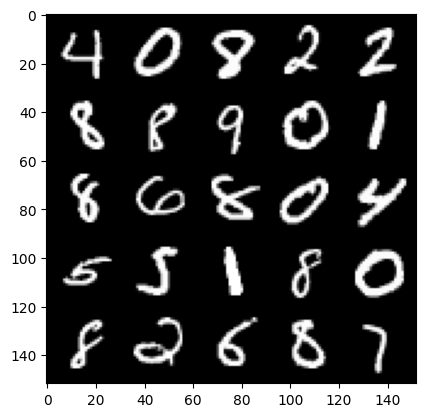

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 94: Step 56500: Generator loss: 0.6941260492801669, discriminator loss: 0.6936905808448788


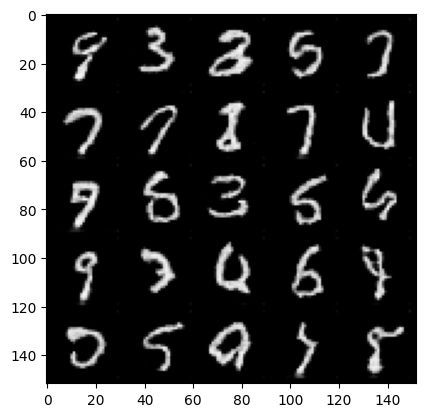

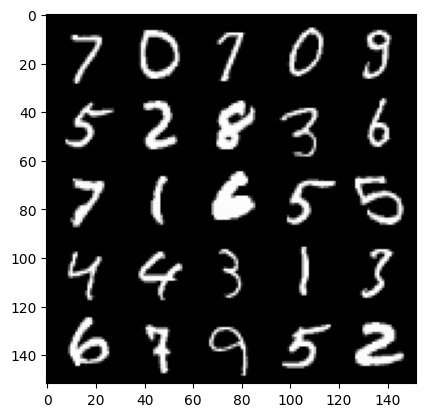

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 95: Step 57000: Generator loss: 0.6945461200475704, discriminator loss: 0.6936926347017287


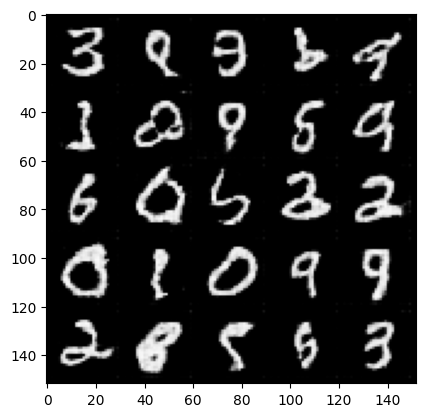

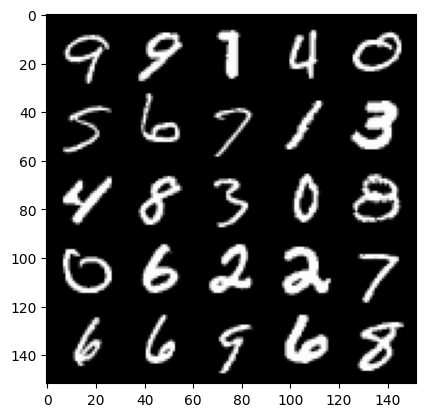

Epoch: 95: Step 57500: Generator loss: 0.6949592217206964, discriminator loss: 0.6936671811342238


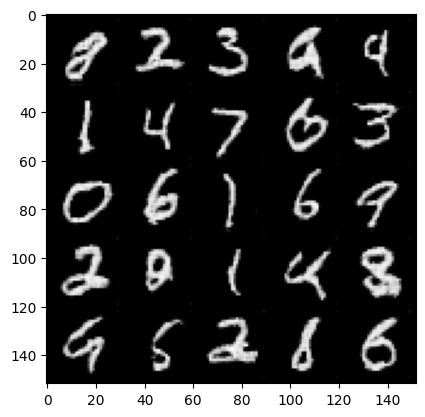

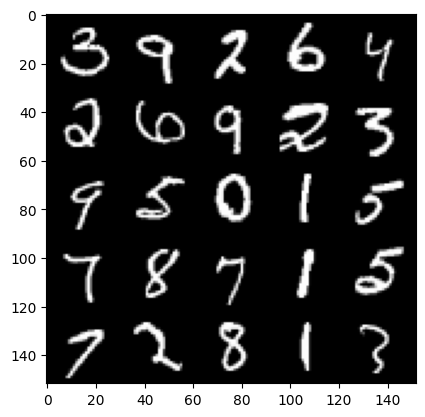

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 96: Step 58000: Generator loss: 0.6936206059455867, discriminator loss: 0.6935470111370086


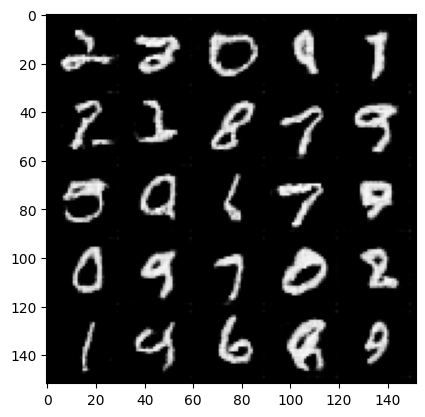

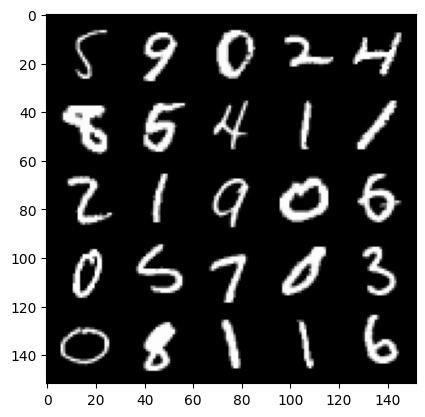

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 97: Step 58500: Generator loss: 0.6945880337953565, discriminator loss: 0.693666304588318


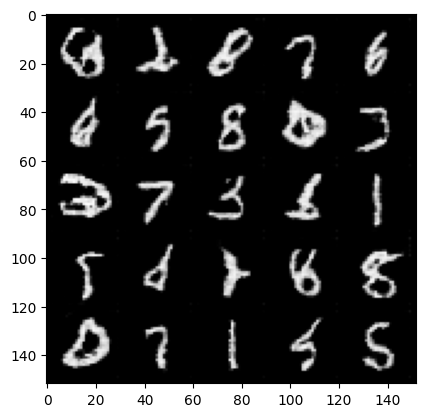

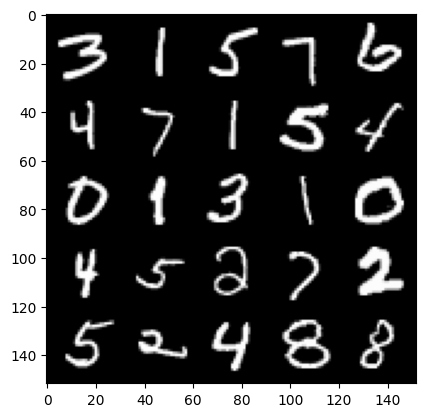

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 98: Step 59000: Generator loss: 0.6949751253128054, discriminator loss: 0.6936209768056876


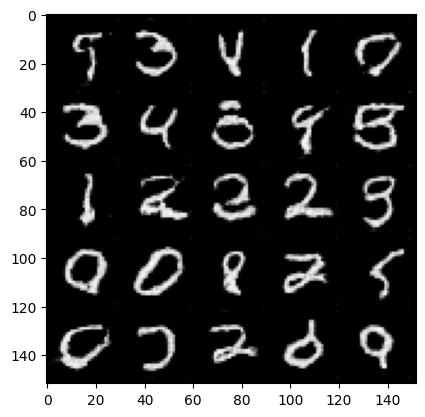

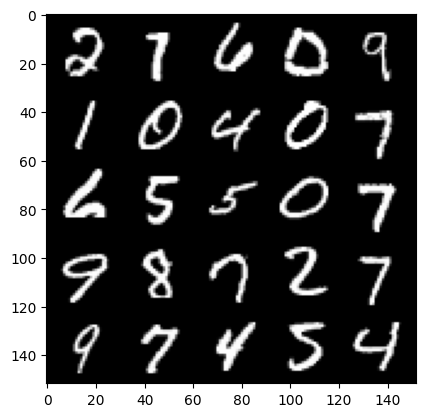

  0%|          | 0/600 [00:00<?, ?it/s]

Epoch: 99: Step 59500: Generator loss: 0.6938181027173997, discriminator loss: 0.6935873553752894


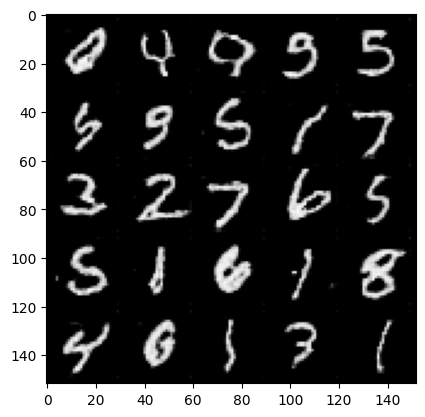

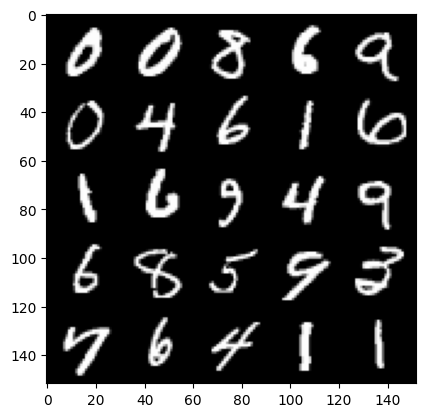

In [ ]:
n_epochs = 100
cur_step = 0
mean_generator_loss = 0
mean_discriminator_loss = 0
m = nn.Sigmoid()
for epoch in range(n_epochs):
    # Dataloader returns the batches
    for real, _ in tqdm(dataloader):
        cur_batch_size = len(real)
        real = real.to(device)

        ## Update discriminator ##
########TODO###
        disc_opt.zero_grad()
        disc_real_pred = disc(real)
        disc_real_pred = m(disc_real_pred)
        label = torch.ones_like(disc_real_pred)
        disc_real_loss = criterion(disc_real_pred,label)
        # disc_real_loss.backward(retain_graph=True)

        noise = get_noise(cur_batch_size, gen.z_dim,device)
        fake = gen(noise)
        disc_fake_pred = disc(fake.detach())
        disc_fake_pred = m(disc_fake_pred)
        label = torch.zeros_like(disc_fake_pred)
        disc_fake_loss = criterion(disc_fake_pred,label)
        # disc_fake_loss.backward(retain_graph=True)

        disc_loss = (disc_real_loss + disc_fake_loss)/2

#########TODO#####



        # Keep track of the average discriminator loss
        mean_discriminator_loss += disc_loss.item() / display_step
        # Update gradients
        disc_loss.backward(retain_graph=True)
        # Update optimizer
        disc_opt.step()

        ## Update generator ##
####TODO####
        gen_opt.zero_grad()
        # noise = get_noise(cur_batch_size, gen.z_dim)
        # fake = gen(noise)
        gen_fake_pred = disc(fake)
        gen_fake_pred = m(gen_fake_pred)
        label = torch.ones_like(gen_fake_pred)

        gen_loss = criterion(gen_fake_pred,label)
        gen_loss.backward(retain_graph=True)
        gen_opt.step()

#####TODO#####

        # Keep track of the average generator loss
        mean_generator_loss += gen_loss.item() / display_step

        ## Visualization code ##
        if cur_step % display_step == 0 and cur_step > 0:
            print(f"Epoch: {epoch}: Step {cur_step}: Generator loss: {mean_generator_loss}, discriminator loss: {mean_discriminator_loss}")
            show_tensor_images(fake)
            show_tensor_images(real)
            mean_generator_loss = 0
            mean_discriminator_loss = 0
        cur_step += 1
